<a href="https://colab.research.google.com/github/hvkchaitanya7/grp3capstone-final/blob/main/code/transformers/ImageCaptiongenerator_Transformer_InceptionV3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#from google.colab import drive
#drive.mount('/content/gdrive')

# New Section

In [ ]:
!rm -rf Flickr8k_Dataset.zip
!rm -rf Flickr8k_text.zip
!wget https://github.com/jbrownlee/Datasets/releases/download/Flickr8k/Flickr8k_Dataset.zip -O Flickr8k_Dataset.zip
!wget https://github.com/jbrownlee/Datasets/releases/download/Flickr8k/Flickr8k_text.zip -O Flickr8k_text.zip
!unzip Flickr8k_Dataset.zip
!unzip Flickr8k_text.zip

Streaming output truncated to the last 5000 lines.
  inflating: __MACOSX/Flicker8k_Dataset/._3429391520_930b153f94.jpg  
  inflating: Flicker8k_Dataset/3429465163_fb8ac7ce7f.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429465163_fb8ac7ce7f.jpg  
  inflating: Flicker8k_Dataset/3429581486_4556471d1a.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429581486_4556471d1a.jpg  
  inflating: Flicker8k_Dataset/3429641260_2f035c1813.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429641260_2f035c1813.jpg  
  inflating: Flicker8k_Dataset/3429956016_3c7e3096c2.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429956016_3c7e3096c2.jpg  
  inflating: Flicker8k_Dataset/3430100177_5864bf1e73.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3430100177_5864bf1e73.jpg  
  inflating: Flicker8k_Dataset/3430287726_94a1825bbf.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3430287726_94a1825bbf.jpg  
  inflating: Flicker8k_Dataset/3430526230_234b3550f6.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3430

In [ ]:
import tensorflow as tf

In [ ]:
import string
import numpy as np
import pandas as pd 
from numpy import array
from PIL import Image
import pickle

import matplotlib.pyplot as plt
import keras
import sys, time, os, warnings 
warnings.filterwarnings("ignore")
import re

import tensorflow as tf
from tqdm import tqdm

from nltk.translate.bleu_score import sentence_bleu

from keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.utils import plot_model
from keras.models import Model
from keras.layers import Input
from keras.layers import Dense, BatchNormalization
from keras.layers import LSTM
from keras.layers import Embedding
from keras.layers import Dropout
from keras.layers.merge import add
from keras.callbacks import ModelCheckpoint
from keras.preprocessing.image import load_img, img_to_array
from keras.preprocessing.text import Tokenizer

from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle

In [ ]:
image_path = "/content/Flicker8k_Dataset"
dir_Flickr_text = "/content/Flickr8k.token.txt"

jpgs = os.listdir(image_path)
print("Total Images in Dataset = {}".format(len(jpgs)))

Total Images in Dataset = 8091


In [ ]:
file = open(dir_Flickr_text,'r')
text = file.read()
file.close()

datatxt = []
for line in text.split('\n'):
    col = line.split('\t')
    if len(col) == 1:
        continue
    w = col[0].split("#")
    datatxt.append(w + [col[1].lower()])

data = pd.DataFrame(datatxt,columns=["filename","index","caption"])
data = data.reindex(columns =['index','filename','caption'])
data = data[data['filename'] != '2258277193_586949ec62.jpg.1']


uni_filenames = np.unique(data.filename.values)
data.head()

,index,filename,caption
0,0,1000268201_693b08cb0e.jpg,a child in a pink dress is climbing up a set o...
1,1,1000268201_693b08cb0e.jpg,a girl going into a wooden building .
2,2,1000268201_693b08cb0e.jpg,a little girl climbing into a wooden playhouse .
3,3,1000268201_693b08cb0e.jpg,a little girl climbing the stairs to her playh...
4,4,1000268201_693b08cb0e.jpg,a little girl in a pink dress going into a woo...


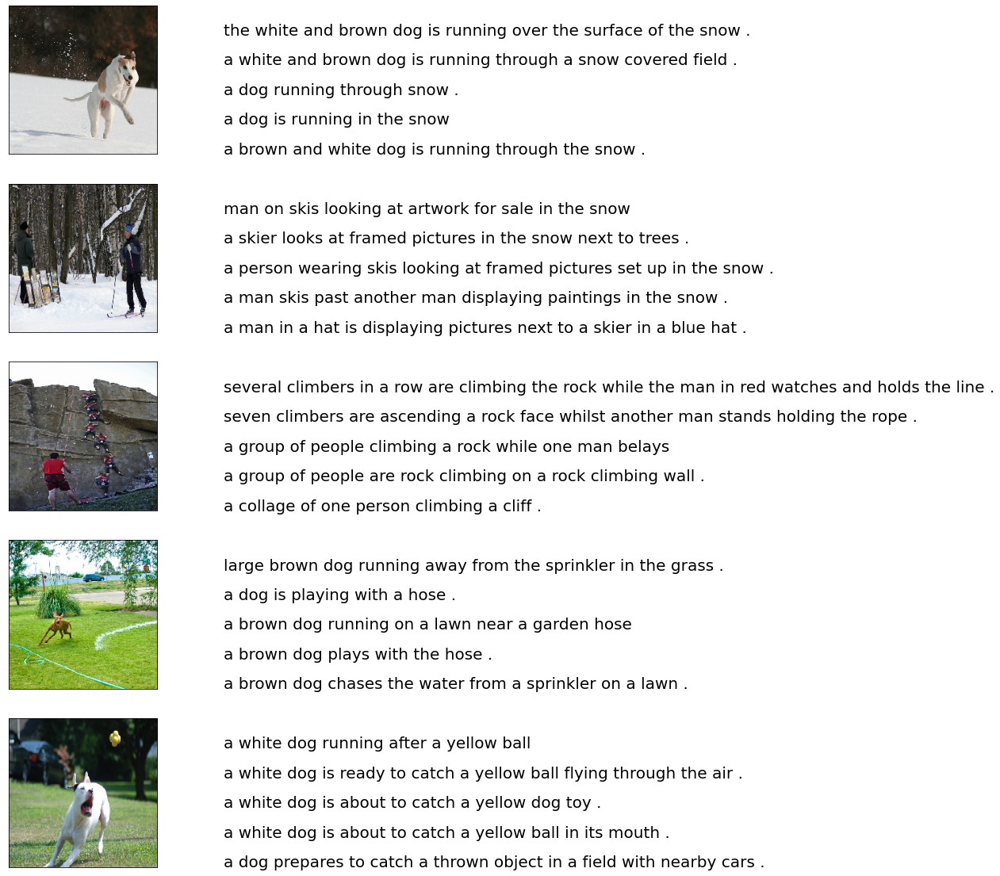

In [ ]:
from keras.preprocessing.image import load_img, img_to_array

npic = 5
npix = 224
target_size = (npix,npix,3)

count = 1
fig = plt.figure(figsize=(10,20))
for jpgfnm in uni_filenames[10:15]:
    filename = image_path + '/' + jpgfnm
    captions = list(data["caption"].loc[data["filename"]==jpgfnm].values)
    image_load = load_img(filename, target_size=target_size)
    
    ax = fig.add_subplot(npic,2,count,xticks=[],yticks=[])
    ax.imshow(image_load)
    count += 1
    
    ax = fig.add_subplot(npic,2,count)
    plt.axis('off')
    ax.plot()
    ax.set_xlim(0,1)
    ax.set_ylim(0,len(captions))
    for i, caption in enumerate(captions):
        ax.text(0,i,caption,fontsize=20)
    count += 1
plt.show()

In [ ]:
vocabulary = []
for txt in data.caption.values:
    vocabulary.extend(txt.split())
print('Vocabulary Size: %d' % len(set(vocabulary)))

Vocabulary Size: 8918


In [ ]:
img = data["filename"].tolist()
caption = data["caption"].tolist()

In [ ]:
print(f"len(img) : {len(img)}")
print(f"len(caption) : {len(caption)}")

len(img) : 40455
len(caption) : 40455


In [ ]:
# To remove punctuations
def remove_punctuation(text_original):
    text_no_punctuation = text_original.translate(string.punctuation)
    return(text_no_punctuation)

# To remove single characters
def remove_single_character(text):
    text_len_more_than1 = ""
    for word in text.split():
        if len(word) > 1:
            text_len_more_than1 += " " + word
    return(text_len_more_than1)

# To remove numeric values
def remove_numeric(text):
    text_no_numeric = ""
    for word in text.split():
        isalpha = word.isalpha()
        if isalpha:
            text_no_numeric += " " + word
    return(text_no_numeric)

In [ ]:
def text_clean(text_original):
    text = remove_punctuation(text_original)
    text = remove_single_character(text)
    text = remove_numeric(text)
    return(text)
    
for i, caption in enumerate(data.caption.values):
    newcaption = text_clean(caption)
    data["caption"].iloc[i] = newcaption

In [ ]:
clean_vocabulary = []
for txt in data.caption.values:
    clean_vocabulary.extend(txt.split())
print('Clean Vocabulary Size: %d' % len(set(clean_vocabulary)))

Clean Vocabulary Size: 8357


In [ ]:
PATH = "/content/Flicker8k_Dataset/"
all_captions = []

for caption  in data["caption"].astype(str):
    caption = '<start> ' + caption+ ' <end>'
    all_captions.append(caption)
all_captions[:10]

['<start>  child in pink dress is climbing up set of stairs in an entry way <end>',
 '<start>  girl going into wooden building <end>',
 '<start>  little girl climbing into wooden playhouse <end>',
 '<start>  little girl climbing the stairs to her playhouse <end>',
 '<start>  little girl in pink dress going into wooden cabin <end>',
 '<start>  black dog and spotted dog are fighting <end>',
 '<start>  black dog and dog playing with each other on the road <end>',
 '<start>  black dog and white dog with brown spots are staring at each other in the street <end>',
 '<start>  two dogs of different breeds looking at each other on the road <end>',
 '<start>  two dogs on pavement moving toward each other <end>']

In [ ]:
all_img_name_vector = []

for annot in data["filename"]:
    full_image_path = PATH + annot

    all_img_name_vector.append(full_image_path)
all_img_name_vector[:10]

['/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1001773457_577c3a7d70.jpg',
 '/content/Flicker8k_Dataset/1001773457_577c3a7d70.jpg',
 '/content/Flicker8k_Dataset/1001773457_577c3a7d70.jpg',
 '/content/Flicker8k_Dataset/1001773457_577c3a7d70.jpg',
 '/content/Flicker8k_Dataset/1001773457_577c3a7d70.jpg']

In [ ]:
print(f"len(all_img_name_vector) : {len(all_img_name_vector)}")
print(f"len(all_captions) : {len(all_captions)}")

len(all_img_name_vector) : 40455
len(all_captions) : 40455


In [ ]:
def data_limiter(num,total_captions,all_img_name_vector):
  train_captions, img_name_vector = shuffle(total_captions,all_img_name_vector,random_state=1)
  train_captions = train_captions[:num]
  img_name_vector = img_name_vector[:num]
  return train_captions,img_name_vector

In [ ]:
train_captions,img_name_vector = data_limiter(40000,all_captions,all_img_name_vector)

In [ ]:
print(f"len(all_img_name_vector) : {len(img_name_vector)}")
print(f"len(all_captions) : {len(train_captions)}")

len(all_img_name_vector) : 40000
len(all_captions) : 40000


In [ ]:
def load_image(image_path):
    img = tf.io.read_file(image_path)
    img = tf.image.decode_jpeg(img, channels=3)
    img = tf.image.resize(img, (299, 299))
    img = tf.keras.applications.inception_v3.preprocess_input(img)
    return img, image_path

In [ ]:
image_model = tf.keras.applications.InceptionV3(include_top=False,
                                                weights='imagenet')
new_input = image_model.input
hidden_layer = image_model.layers[-1].output

image_features_extract_model = tf.keras.Model(new_input, hidden_layer)

87924736/87910968 [==============================] - 0s 0us/step


In [ ]:
# Get unique images
encode_train = sorted(set(img_name_vector))

# Feel free to change batch_size according to your system configuration
image_dataset = tf.data.Dataset.from_tensor_slices(encode_train)
image_dataset = image_dataset.map(
  load_image, num_parallel_calls=tf.data.experimental.AUTOTUNE).batch(16)

for img, path in tqdm(image_dataset):
  batch_features = image_features_extract_model(img)
  batch_features = tf.reshape(batch_features,
                              (batch_features.shape[0], -1, batch_features.shape[3]))

  for bf, p in zip(batch_features, path):
    path_of_feature = p.numpy().decode("utf-8")
    np.save(path_of_feature, bf.numpy())

100%|██████████| 506/506 [02:21<00:00,  3.56it/s]


### Preprocess and tokenize the captions

In [ ]:
top_k = 5000

In [ ]:
tokenizer = tf.keras.preprocessing.text.Tokenizer(num_words=top_k,
                                                  oov_token="<unk>",
                                                  filters='!"#$%&()*+.,-/:;=?@[\]^_`{|}~ ')
tokenizer.fit_on_texts(train_captions)
train_seqs = tokenizer.texts_to_sequences(train_captions)

In [ ]:
tokenizer.word_index['<pad>'] = 0
tokenizer.index_word[0] = '<pad>'

In [ ]:
train_seqs = tokenizer.texts_to_sequences(train_captions)

In [ ]:
cap_vector = tf.keras.preprocessing.sequence.pad_sequences(train_seqs, padding='post')

In [ ]:
cap_vector.shape

(40000, 33)

### Split the data into training and testing

In [ ]:
img_name_train, img_name_val, cap_train, cap_val = train_test_split(img_name_vector,
                                                                    cap_vector,
                                                                    test_size=0.2,
                                                                    random_state=0)

In [ ]:
len(img_name_train), len(cap_train), len(img_name_val), len(cap_val)

(32000, 32000, 8000, 8000)

### Create a tf.data dataset for training

In [ ]:
BATCH_SIZE = 64
BUFFER_SIZE = 1000
num_steps = len(img_name_train) // BATCH_SIZE

In [ ]:
def map_func(img_name, cap):
  img_tensor = np.load(img_name.decode('utf-8')+'.npy')
  return img_tensor, cap

In [ ]:
dataset = tf.data.Dataset.from_tensor_slices((img_name_train, cap_train))

# Use map to load the numpy files in parallel
dataset = dataset.map(lambda item1, item2: tf.numpy_function(
          map_func, [item1, item2], [tf.float32, tf.int32]),
          num_parallel_calls=tf.data.experimental.AUTOTUNE)

# Shuffle and batch
dataset = dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
dataset = dataset.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

In [ ]:
def get_angles(pos, i, d_model):
   angle_rates = 1 / np.power(10000, (2 * (i//2)) / np.float32(d_model))
   return pos * angle_rates

In [ ]:
def positional_encoding_1d(position, d_model):
  angle_rads = get_angles(np.arange(position)[:, np.newaxis],
                          np.arange(d_model)[np.newaxis, :],
                          d_model)
  
  # apply sin to even indices in the array; 2i
  angle_rads[:, 0::2] = np.sin(angle_rads[:, 0::2])
  
  # apply cos to odd indices in the array; 2i+1
  angle_rads[:, 1::2] = np.cos(angle_rads[:, 1::2])
    
  pos_encoding = angle_rads[np.newaxis, ...]
    
  return tf.cast(pos_encoding, dtype=tf.float32)

In [ ]:
def positional_encoding_2d(row,col,d_model):
  assert d_model % 2 == 0
  # first d_model/2 encode row embedding and second d_model/2 encode column embedding
  row_pos = np.repeat(np.arange(row),col)[:,np.newaxis]
  col_pos = np.repeat(np.expand_dims(np.arange(col),0),row,axis=0).reshape(-1,1)
  angle_rads_row = get_angles(row_pos,np.arange(d_model//2)[np.newaxis,:],d_model//2)
  angle_rads_col = get_angles(col_pos,np.arange(d_model//2)[np.newaxis,:],d_model//2)
  #apply sin and cos to odd and even indices resp.
  angle_rads_row[:, 0::2] = np.sin(angle_rads_row[:, 0::2])
  angle_rads_row[:, 1::2] = np.cos(angle_rads_row[:, 1::2])
  angle_rads_col[:, 0::2] = np.sin(angle_rads_col[:, 0::2])
  angle_rads_col[:, 1::2] = np.cos(angle_rads_col[:, 1::2])
  pos_encoding = np.concatenate([angle_rads_row,angle_rads_col],axis=1)[np.newaxis, ...]

  return tf.cast(pos_encoding, dtype=tf.float32)


In [ ]:
def create_padding_mask(seq):
  seq = tf.cast(tf.math.equal(seq, 0), tf.float32)
  
  # add extra dimensions to add the padding
  # to the attention logits.
  return seq[:, tf.newaxis, tf.newaxis, :]  # (batch_size, 1, 1, seq_len)

In [ ]:
def create_look_ahead_mask(size):
  mask = 1 - tf.linalg.band_part(tf.ones((size, size)), -1, 0)
  return mask  # (seq_len, seq_len)

In [ ]:
def scaled_dot_product_attention(q, k, v, mask):
  """Calculate the attention weights.
  q, k, v must have matching leading dimensions.
  k, v must have matching penultimate dimension, i.e.: seq_len_k = seq_len_v.
  The mask has different shapes depending on its type(padding or look ahead) 
  but it must be broadcastable for addition.
  
  Args:
    q: query shape == (..., seq_len_q, depth)
    k: key shape == (..., seq_len_k, depth)
    v: value shape == (..., seq_len_v, depth_v)
    mask: Float tensor with shape broadcastable 
          to (..., seq_len_q, seq_len_k). Defaults to None.
    
  Returns:
    output, attention_weights
  """

  matmul_qk = tf.matmul(q, k, transpose_b=True)  # (..., seq_len_q, seq_len_k)
  
  # scale matmul_qk
  dk = tf.cast(tf.shape(k)[-1], tf.float32)
  scaled_attention_logits = matmul_qk / tf.math.sqrt(dk)

  # add the mask to the scaled tensor.
  if mask is not None:
    scaled_attention_logits += (mask * -1e9)  #adding -Inf where mask is 1 s.t. value get ignored in softmax

  # softmax is normalized on the last axis (seq_len_k) so that the scores
  # add up to 1.
  attention_weights = tf.nn.softmax(scaled_attention_logits, axis=-1)  # (..., seq_len_q, seq_len_k)

  output = tf.matmul(attention_weights, v)  # (..., seq_len_q, depth_v)

  return output, attention_weights

In [ ]:
class MultiHeadAttention(tf.keras.layers.Layer):
  def __init__(self, d_model, num_heads):
    super(MultiHeadAttention, self).__init__()
    self.num_heads = num_heads
    self.d_model = d_model
    
    assert d_model % self.num_heads == 0
    
    self.depth = d_model // self.num_heads
    
    self.wq = tf.keras.layers.Dense(d_model)
    self.wk = tf.keras.layers.Dense(d_model)
    self.wv = tf.keras.layers.Dense(d_model)
    
    self.dense = tf.keras.layers.Dense(d_model)
        
  def split_heads(self, x, batch_size):
    """Split the last dimension into (num_heads, depth).
    Transpose the result such that the shape is (batch_size, num_heads, seq_len, depth)
    """
    #
    x = tf.reshape(x, (batch_size, -1, self.num_heads, self.depth))
    return tf.transpose(x, perm=[0, 2, 1, 3])
    
  def call(self, v, k, q, mask=None):
    batch_size = tf.shape(q)[0]
    
    q = self.wq(q)  # (batch_size, seq_len, d_model)
    k = self.wk(k)  # (batch_size, seq_len, d_model)
    v = self.wv(v)  # (batch_size, seq_len, d_model)
    
    q = self.split_heads(q, batch_size)  # (batch_size, num_heads, seq_len_q, depth)
    k = self.split_heads(k, batch_size)  # (batch_size, num_heads, seq_len_k, depth)
    v = self.split_heads(v, batch_size)  # (batch_size, num_heads, seq_len_v, depth)
    
    # scaled_attention.shape == (batch_size, num_heads, seq_len_q, depth)
    # attention_weights.shape == (batch_size, num_heads, seq_len_q, seq_len_k)
    scaled_attention, attention_weights = scaled_dot_product_attention(
        q, k, v, mask)
    
    scaled_attention = tf.transpose(scaled_attention, perm=[0, 2, 1, 3])  # (batch_size, seq_len_q, num_heads, depth)

    concat_attention = tf.reshape(scaled_attention, 
                                  (batch_size, -1, self.d_model))  # (batch_size, seq_len_q, d_model)

    output = self.dense(concat_attention)  # (batch_size, seq_len_q, d_model)
        
    return output, attention_weights

In [ ]:
def point_wise_feed_forward_network(d_model, dff):
  return tf.keras.Sequential([
      tf.keras.layers.Dense(dff, activation='relu'),  # (batch_size, seq_len, dff)
      tf.keras.layers.Dense(d_model)  # (batch_size, seq_len, d_model)
  ])

In [ ]:
class EncoderLayer(tf.keras.layers.Layer):
  def __init__(self, d_model, num_heads, dff, rate=0.1):
    super(EncoderLayer, self).__init__()

    self.mha = MultiHeadAttention(d_model, num_heads)
    self.ffn = point_wise_feed_forward_network(d_model, dff)

    self.layernorm1 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    self.layernorm2 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    
    self.dropout1 = tf.keras.layers.Dropout(rate)
    self.dropout2 = tf.keras.layers.Dropout(rate)
    
  def call(self, x, training, mask=None):

    attn_output, _ = self.mha(x, x, x, mask)  # (batch_size, input_seq_len, d_model)
    attn_output = self.dropout1(attn_output, training=training)
    out1 = self.layernorm1(x + attn_output)  # (batch_size, input_seq_len, d_model)
    
    ffn_output = self.ffn(out1)  # (batch_size, input_seq_len, d_model)
    ffn_output = self.dropout2(ffn_output, training=training)
    out2 = self.layernorm2(out1 + ffn_output)  # (batch_size, input_seq_len, d_model)
    
    return out2

In [ ]:
class DecoderLayer(tf.keras.layers.Layer):
  def __init__(self, d_model, num_heads, dff, rate=0.1):
    super(DecoderLayer, self).__init__()

    self.mha1 = MultiHeadAttention(d_model, num_heads)
    self.mha2 = MultiHeadAttention(d_model, num_heads)

    self.ffn = point_wise_feed_forward_network(d_model, dff)
 
    self.layernorm1 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    self.layernorm2 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    self.layernorm3 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    
    self.dropout1 = tf.keras.layers.Dropout(rate)
    self.dropout2 = tf.keras.layers.Dropout(rate)
    self.dropout3 = tf.keras.layers.Dropout(rate)
    
    
  def call(self, x, enc_output, training, 
           look_ahead_mask=None, padding_mask=None):
    # enc_output.shape == (batch_size, input_seq_len, d_model)

    # using look ahead mask so that during self attention current query dont consider future token
    attn1, attn_weights_block1 = self.mha1(x, x, x, look_ahead_mask)  # (batch_size, target_seq_len, d_model)
    attn1 = self.dropout1(attn1, training=training)
    out1 = self.layernorm1(attn1 + x)
    
    # use padding mask to avoid padded values of both enc_output and dec_input
    attn2, attn_weights_block2 = self.mha2(
        enc_output, enc_output, out1, padding_mask)  # (batch_size, target_seq_len, d_model)
    attn2 = self.dropout2(attn2, training=training)
    out2 = self.layernorm2(attn2 + out1)  # (batch_size, target_seq_len, d_model)
    
    ffn_output = self.ffn(out2)  # (batch_size, target_seq_len, d_model)
    ffn_output = self.dropout3(ffn_output, training=training)
    out3 = self.layernorm3(ffn_output + out2)  # (batch_size, target_seq_len, d_model)
    
    return out3, attn_weights_block1, attn_weights_block2

In [ ]:
class Encoder(tf.keras.layers.Layer):
  def __init__(self, num_layers, d_model, num_heads, dff,
               row_size,col_size,rate=0.1):
    super(Encoder, self).__init__()

    self.d_model = d_model
    self.num_layers = num_layers
    
    self.embedding = tf.keras.layers.Dense(self.d_model,activation='relu')
    self.pos_encoding = positional_encoding_2d(row_size,col_size, 
                                            self.d_model)
    
    
    self.enc_layers = [EncoderLayer(d_model, num_heads, dff, rate) 
                       for _ in range(num_layers)]
  
    self.dropout = tf.keras.layers.Dropout(rate)
        
  def call(self, x, training, mask=None):
    # shape(x) = (batch_size,seq_len(H*W),features)
    seq_len = tf.shape(x)[1]
    
    # adding embedding and position encoding.
    x = self.embedding(x)  # (batch_size, input_seq_len(H*W), d_model)
    x += self.pos_encoding[:, :seq_len, :]

    x = self.dropout(x, training=training)
    
    for i in range(self.num_layers):
      x = self.enc_layers[i](x, training, mask)
    
    return x  # (batch_size, input_seq_len, d_model)

In [ ]:
class Decoder(tf.keras.layers.Layer):
  def __init__(self, num_layers, d_model, num_heads, dff, target_vocab_size,
               maximum_position_encoding, rate=0.1):
    super(Decoder, self).__init__()

    self.d_model = d_model
    self.num_layers = num_layers
    
    self.embedding = tf.keras.layers.Embedding(target_vocab_size, d_model)
    self.pos_encoding = positional_encoding_1d(maximum_position_encoding, d_model)
    
    self.dec_layers = [DecoderLayer(d_model, num_heads, dff, rate) 
                       for _ in range(num_layers)]
    self.dropout = tf.keras.layers.Dropout(rate)
    
  def call(self, x, enc_output, training, 
           look_ahead_mask=None, padding_mask=None):

    seq_len = tf.shape(x)[1]
    attention_weights = {}
    
    x = self.embedding(x)  # (batch_size, target_seq_len, d_model)
    x *= tf.math.sqrt(tf.cast(self.d_model, tf.float32))# WHY ?
    x += self.pos_encoding[:, :seq_len, :]
    
    x = self.dropout(x, training=training)

    for i in range(self.num_layers):
      x, block1, block2 = self.dec_layers[i](x, enc_output, training,
                                             look_ahead_mask, padding_mask)
      
      attention_weights['decoder_layer{}_block1'.format(i+1)] = block1
      attention_weights['decoder_layer{}_block2'.format(i+1)] = block2
    
    # x.shape == (batch_size, target_seq_len, d_model)
    return x, attention_weights

In [ ]:
class Transformer(tf.keras.Model):
#_int_(num_layers = 4, d_model=512 , num_heads = 8, dff=2048,row_size=8,col_soze = 8, target_vocab_size = 8091+1 ,max_pos_encoding = vocab_size,rate=0.1 )
  def __init__(self, num_layers, d_model, num_heads, dff,row_size,col_size, 
               target_vocab_size,max_pos_encoding, rate=0.1):
    super(Transformer, self).__init__()

    self.encoder = Encoder(num_layers, d_model, num_heads, dff,row_size,col_size, rate)

    self.decoder = Decoder(num_layers, d_model, num_heads, dff, 
                           target_vocab_size,max_pos_encoding, rate)

    self.final_layer = tf.keras.layers.Dense(target_vocab_size)
    
  def call(self, inp, tar, training,look_ahead_mask=None, dec_padding_mask=None,enc_padding_mask=None):

    enc_output = self.encoder(inp, training, enc_padding_mask)  # (batch_size, inp_seq_len, d_model)
    
    # dec_output.shape == (batch_size, tar_seq_len, d_model)
    dec_output, attention_weights = self.decoder(
        tar, enc_output, training, look_ahead_mask, dec_padding_mask)
    
    final_output = self.final_layer(dec_output)  # (batch_size, tar_seq_len, target_vocab_size)
    
    return final_output, attention_weights

In [ ]:
num_layer = 4
d_model = 512
dff = 2048
num_heads = 8
row_size = 8
col_size = 8
target_vocab_size = top_k + 1
dropout_rate = 0.1

In [ ]:
print (target_vocab_size)

5001


In [ ]:
np.arange(target_vocab_size)

array([   0,    1,    2, ..., 4998, 4999, 5000])

In [ ]:
angle_check = get_angles(np.arange(target_vocab_size)[:, np.newaxis],
                          np.arange(512)[np.newaxis, :],
                          512)
print (angle_check.shape)
print(type(angle_check))

(5001, 512)
<class 'numpy.ndarray'>


In [ ]:
# apply sin to even indices in the array; 2i
angle_check[:, 0::2] = np.sin(angle_check[:, 0::2])
print(angle_check.shape)
# apply cos to odd indices in the array; 2i+1
angle_check[:, 1::2] = np.cos(angle_check[:, 1::2])
pos_encoding_check = angle_check[np.newaxis, ...]
print(pos_encoding_check.shape)

(5001, 512)
(1, 5001, 512)


In [ ]:
  row_pos1 = np.repeat(np.arange(8),8)[:,np.newaxis]
  print("row_pos1", row_pos1.shape)
  col_pos1 = np.repeat(np.expand_dims(np.arange(8),0),8,axis=0).reshape(-1,1)
  print("row_pos1", col_pos1.shape)
  angle_rads_row1 = get_angles(row_pos1,np.arange(512//2)[np.newaxis,:],d_model//2)
  print("angle_rads_row1", angle_rads_row1.shape)
  angle_rads_col1 = get_angles(col_pos1,np.arange(512//2)[np.newaxis,:],d_model//2)
  print("angle_rads_col1", angle_rads_col1.shape)
  #apply sin and cos to odd and even indices resp.
  angle_rads_row1[:, 0::2] = np.sin(angle_rads_row1[:, 0::2])
  angle_rads_row1[:, 1::2] = np.cos(angle_rads_row1[:, 1::2])
  print("angle_rads_row1-1", angle_rads_row1.shape)
  print("angle_rads_col1-1", angle_rads_col1.shape)
  angle_rads_col1[:, 0::2] = np.sin(angle_rads_col1[:, 0::2])
  angle_rads_col1[:, 1::2] = np.cos(angle_rads_col1[:, 1::2])
  print("angle_rads_row1-2", angle_rads_row1.shape)
  print("angle_rads_col1-2", angle_rads_col1.shape)
  pos_encoding1 = np.concatenate([angle_rads_row1,angle_rads_col1],axis=1)[np.newaxis, ...]
  print("pos_encoding1", pos_encoding1.shape)

row_pos1 (64, 1)
row_pos1 (64, 1)
angle_rads_row1 (64, 256)
angle_rads_col1 (64, 256)
angle_rads_row1-1 (64, 256)
angle_rads_col1-1 (64, 256)
angle_rads_row1-2 (64, 256)
angle_rads_col1-2 (64, 256)
pos_encoding1 (1, 64, 512)


In [ ]:
class CustomSchedule(tf.keras.optimizers.schedules.LearningRateSchedule):
  def __init__(self, d_model, warmup_steps=4000):
    super(CustomSchedule, self).__init__()
    
    self.d_model = d_model
    self.d_model = tf.cast(self.d_model, tf.float32)

    self.warmup_steps = warmup_steps
    
  def __call__(self, step):
    arg1 = tf.math.rsqrt(step)
    arg2 = step * (self.warmup_steps ** -1.5)
    
    return tf.math.rsqrt(self.d_model) * tf.math.minimum(arg1, arg2)

In [ ]:
learning_rate = CustomSchedule(d_model)

optimizer = tf.keras.optimizers.Adam(learning_rate, beta_1=0.9, beta_2=0.98, 
                                     epsilon=1e-9)

In [ ]:
loss_object = tf.keras.losses.SparseCategoricalCrossentropy(
    from_logits=True, reduction='none')

In [ ]:
def loss_function(real, pred):
  mask = tf.math.logical_not(tf.math.equal(real, 0))
  loss_ = loss_object(real, pred)

  mask = tf.cast(mask, dtype=loss_.dtype)
  loss_ *= mask
  
  return tf.reduce_sum(loss_)/tf.reduce_sum(mask)

In [ ]:
train_loss = tf.keras.metrics.Mean(name='train_loss')
train_accuracy = tf.keras.metrics.SparseCategoricalAccuracy(
    name='train_accuracy')

In [ ]:
transformer = Transformer(num_layer,d_model,num_heads,dff,row_size,col_size,target_vocab_size,max_pos_encoding=target_vocab_size,rate=dropout_rate)

In [ ]:
def create_masks_decoder(tar):
  look_ahead_mask = create_look_ahead_mask(tf.shape(tar)[1])
  dec_target_padding_mask = create_padding_mask(tar)
  combined_mask = tf.maximum(dec_target_padding_mask, look_ahead_mask)
  return combined_mask

In [ ]:
@tf.function
def train_step(img_tensor, tar):
  tar_inp = tar[:, :-1]
  tar_real = tar[:, 1:]
  
  dec_mask = create_masks_decoder(tar_inp)
  
  with tf.GradientTape() as tape:
    predictions, _ = transformer(img_tensor, tar_inp, 
                                 True,  
                                 dec_mask)
    loss = loss_function(tar_real, predictions)

  gradients = tape.gradient(loss, transformer.trainable_variables)    
  optimizer.apply_gradients(zip(gradients, transformer.trainable_variables))
  
  train_loss(loss)
  train_accuracy(tar_real, predictions)

In [ ]:
for epoch in range(70):
  start = time.time()
  
  train_loss.reset_states()
  train_accuracy.reset_states()
  
  for (batch, (img_tensor, tar)) in enumerate(dataset):
    train_step(img_tensor, tar)
    
    if batch % 50 == 0:
      print ('Epoch {} Batch {} Loss {:.4f} Accuracy {:.4f}'.format(
          epoch + 1, batch, train_loss.result(), train_accuracy.result()))
      
    
  print ('Epoch {} Loss {:.4f} Accuracy {:.4f}'.format(epoch + 1, 
                                                train_loss.result(), 
                                                train_accuracy.result()))

  print ('Time taken for 1 epoch: {} secs\n'.format(time.time() - start))

Epoch 1 Batch 0 Loss 8.6085 Accuracy 0.0000
Epoch 1 Batch 50 Loss 8.1814 Accuracy 0.0182
Epoch 1 Batch 100 Loss 7.7566 Accuracy 0.0247
Epoch 1 Batch 150 Loss 7.4436 Accuracy 0.0277
Epoch 1 Batch 200 Loss 7.1424 Accuracy 0.0309
Epoch 1 Batch 250 Loss 6.8590 Accuracy 0.0349
Epoch 1 Batch 300 Loss 6.6097 Accuracy 0.0388
Epoch 1 Batch 350 Loss 6.3921 Accuracy 0.0422
Epoch 1 Batch 400 Loss 6.1992 Accuracy 0.0456
Epoch 1 Batch 450 Loss 6.0321 Accuracy 0.0487
Epoch 1 Loss 5.8850 Accuracy 0.0514
Time taken for 1 epoch: 92.24063014984131 secs

Epoch 2 Batch 0 Loss 4.4433 Accuracy 0.0757
Epoch 2 Batch 50 Loss 4.3919 Accuracy 0.0805
Epoch 2 Batch 100 Loss 4.3530 Accuracy 0.0818
Epoch 2 Batch 150 Loss 4.3099 Accuracy 0.0825
Epoch 2 Batch 200 Loss 4.2527 Accuracy 0.0834
Epoch 2 Batch 250 Loss 4.2090 Accuracy 0.0844
Epoch 2 Batch 300 Loss 4.1675 Accuracy 0.0855
Epoch 2 Batch 350 Loss 4.1292 Accuracy 0.0862
Epoch 2 Batch 400 Loss 4.0915 Accuracy 0.0870
Epoch 2 Batch 450 Loss 4.0540 Accuracy 0.0880
Ep

In [ ]:
transformer.save_weights('image_caption_transformer_45.h5')

In [ ]:
def evaluate(image):

  temp_input = tf.expand_dims(load_image(image)[0], 0)
  img_tensor_val = image_features_extract_model(temp_input)
  img_tensor_val = tf.reshape(img_tensor_val, (img_tensor_val.shape[0], -1, img_tensor_val.shape[3]))
  
  start_token = tokenizer.word_index['<start>']
  end_token = tokenizer.word_index['<end>']
   
  #decoder input is start token.
  decoder_input = [start_token]
  output = tf.expand_dims(decoder_input, 0) #tokens
  result = [] #word list

  for i in range(100):
      dec_mask = create_masks_decoder(output)
  
      # predictions.shape == (batch_size, seq_len, vocab_size)
      predictions, attention_weights = transformer(img_tensor_val,output,False,dec_mask)
      
      # select the last word from the seq_len dimension
      predictions = predictions[: ,-1:, :]  # (batch_size, 1, vocab_size)

      predicted_id = tf.cast(tf.argmax(predictions, axis=-1), tf.int32)
      # return the result if the predicted_id is equal to the end token
      if predicted_id == end_token:
          return result,tf.squeeze(output, axis=0), attention_weights
      # concatentate the predicted_id to the output which is given to the decoder
      # as its input.
      result.append(tokenizer.index_word[int(predicted_id)])
      output = tf.concat([output, predicted_id], axis=-1)

  return result,tf.squeeze(output, axis=0), attention_weights

BLEU-1 score: 53.333333333333336
BLEU-2 score: 43.64357804719848
BLEU-3 score: 39.165671746208716
BLEU-4 score: 24.60137257692754
Real Caption: the man is standing on stone stump on top of hill with his arms outstretched
Predicted Caption: man with short hair is standing on stone base with his arms out like bird


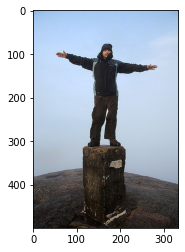

In [ ]:
start_token = tokenizer.word_index['<start>']
end_token = tokenizer.word_index['<end>']
# select random image from validation data
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
caption,result,attention_weights = evaluate(image)

first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in caption:
    if i=="<unk>":
        caption.remove(i)

for i in real_caption:
    if i=="<unk>":
        real_caption.remove(i)

#remove <end> from result         
result_join = ' '.join(caption)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = caption
score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
print(f"BLEU-1 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
print(f"BLEU-2 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
print(f"BLEU-3 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
print(f"BLEU-4 score: {score*100}")

print ('Real Caption:', real_caption)
print ('Predicted Caption:', ' '.join(caption))
temp_image = np.array(Image.open(image))
plt.imshow(temp_image)


BLEU-1 score: 12.262648039048077
BLEU-2 score: 3.168232950523297e-153
BLEU-3 score: 6.776037495668201e-184
BLEU-4 score: 5.092529201164552e-230
Real Caption: hiker with an american flag on his backpack walks through the woods
Predicted Caption: hiker is pointing towards the mountains


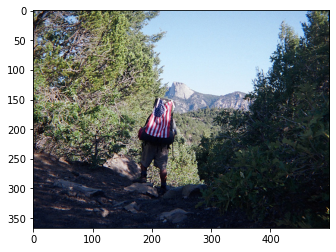

In [ ]:
start_token = tokenizer.word_index['<start>']
end_token = tokenizer.word_index['<end>']
# select random image from validation data
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
caption,result,attention_weights = evaluate(image)

first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in caption:
    if i=="<unk>":
        caption.remove(i)

for i in real_caption:
    if i=="<unk>":
        real_caption.remove(i)

#remove <end> from result         
result_join = ' '.join(caption)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = caption
score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
print(f"BLEU-1 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
print(f"BLEU-2 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
print(f"BLEU-3 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
print(f"BLEU-4 score: {score*100}")

print ('Real Caption:', real_caption)
print ('Predicted Caption:', ' '.join(caption))
temp_image = np.array(Image.open(image))
plt.imshow(temp_image)


BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229
Real Caption: two young men do cycle figures on ramp
Predicted Caption: two people wearing blue shirt and shorts are riding on bike


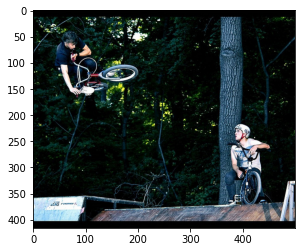

In [ ]:
start_token = tokenizer.word_index['<start>']
end_token = tokenizer.word_index['<end>']
# select random image from validation data
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
caption,result,attention_weights = evaluate(image)

first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in caption:
    if i=="<unk>":
        caption.remove(i)

for i in real_caption:
    if i=="<unk>":
        real_caption.remove(i)

#remove <end> from result         
result_join = ' '.join(caption)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = caption
score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
print(f"BLEU-1 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
print(f"BLEU-2 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
print(f"BLEU-3 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
print(f"BLEU-4 score: {score*100}")

print ('Real Caption:', real_caption)
print ('Predicted Caption:', ' '.join(caption))
temp_image = np.array(Image.open(image))
plt.imshow(temp_image)


BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229
Real Caption: dog jumping for frisbee while woman crouches nearby
Predicted Caption: the girl is doing freestyle frisbee in the baseball field with her dog at the baseball


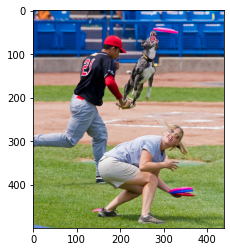

In [ ]:
start_token = tokenizer.word_index['<start>']
end_token = tokenizer.word_index['<end>']
# select random image from validation data
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
caption,result,attention_weights = evaluate(image)

first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in caption:
    if i=="<unk>":
        caption.remove(i)

for i in real_caption:
    if i=="<unk>":
        real_caption.remove(i)

#remove <end> from result         
result_join = ' '.join(caption)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = caption
score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
print(f"BLEU-1 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
print(f"BLEU-2 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
print(f"BLEU-3 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
print(f"BLEU-4 score: {score*100}")

print ('Real Caption:', real_caption)
print ('Predicted Caption:', ' '.join(caption))
temp_image = np.array(Image.open(image))
plt.imshow(temp_image)


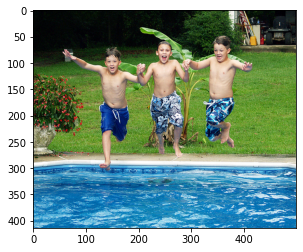

Real Caption: three young boys in blue swimming trunks hold hands and jump into an inground pool
Predicted Caption: two boys are playing in an above the pool
BLEU-1 score: 22.818538623670754
BLEU-2 score: 5.105653081301752e-153
BLEU-3 score: 1.0309135521852637e-183
BLEU-4 score: 7.63718022611286e-230


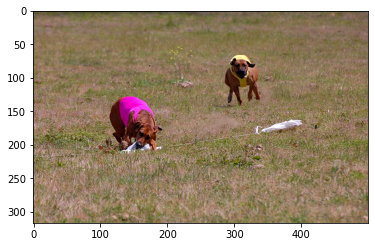

Real Caption: the two dogs with clothing are in flat uncut field
Predicted Caption: two dogs one with frisbee
BLEU-1 score: 22.07276647028654
BLEU-2 score: 14.247909490690875
BLEU-3 score: 1.0537466943570253e-91
BLEU-4 score: 3.4150773803399635e-153


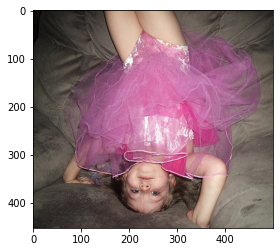

Real Caption: girl in pick dress stands upside down
Predicted Caption: the little girl in the pink wig and is standing in front of man with the colorful boots under her
BLEU-1 score: 10.000000000000002
BLEU-2 score: 7.2547625011001164
BLEU-3 score: 1.0485212803193078e-91
BLEU-4 score: 4.0177583788571546e-153


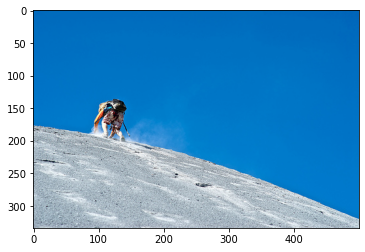

Real Caption: person walks up white sandy hill against the blue sky
Predicted Caption: person is hiking in the sand with mountain behind him
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229


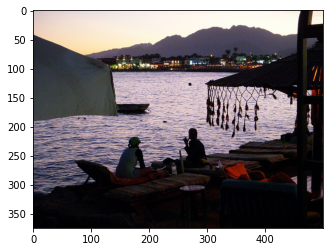

Real Caption: two people on cots watching the water at twilight
Predicted Caption: two people sit in the shadows near the water
BLEU-1 score: 44.44444444444444
BLEU-2 score: 33.333333333333336
BLEU-3 score: 2.617764516460675e-91
BLEU-4 score: 8.612150057732662e-153


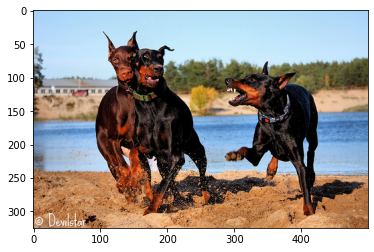

Real Caption: one dog is bearing its teeth at the other two dogs as they run beside the water
Predicted Caption: two dogs playing in the sand
BLEU-1 score: 7.993987303984694
BLEU-2 score: 5.055841493412091
BLEU-3 score: 4.0550552820383696e-92
BLEU-4 score: 1.341113905439655e-153


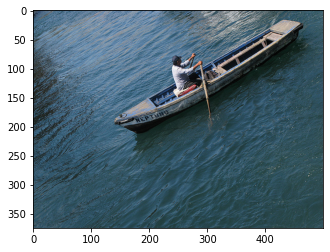

Real Caption: man rowing boat
Predicted Caption: the fisherman paddles in his to new spot
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


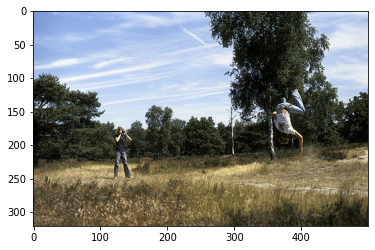

Real Caption: man doing back flip while another takes picture
Predicted Caption: young man takes picture of another person doing gymnastics in field
BLEU-1 score: 45.45454545454545
BLEU-2 score: 21.320071635561046
BLEU-3 score: 2.0020574018996266e-91
BLEU-4 score: 6.887578243315168e-153


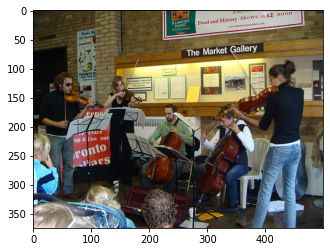

Real Caption: the string <unk> plays for an audience
Predicted Caption: group of people play instruments in public
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


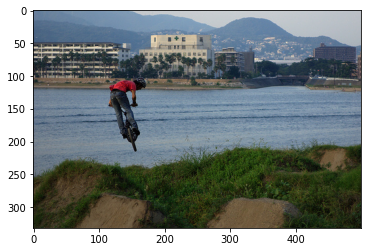

Real Caption: person is on bike in midair
Predicted Caption: person is riding his bicycle and is flying through the air on lake in front of lake
BLEU-1 score: 23.529411764705884
BLEU-2 score: 12.126781251816652
BLEU-3 score: 1.4270876757460378e-91
BLEU-4 score: 5.194514794593801e-153


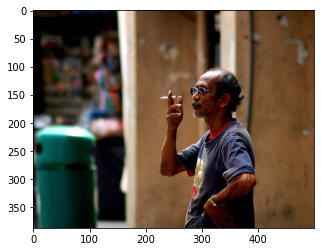

Real Caption: dark skinned man smoking cigarette near green trashcan
Predicted Caption: the man is wearing blue shirt and holding up newspaper
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229


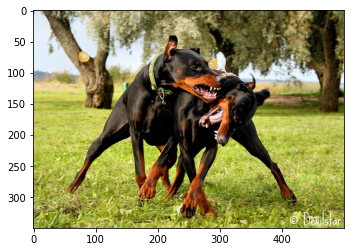

Real Caption: two dogs play together
Predicted Caption: two dogs are playing together outside
BLEU-1 score: 50.0
BLEU-2 score: 31.6227766016838
BLEU-3 score: 2.536315813271983e-91
BLEU-4 score: 8.38826642100846e-153


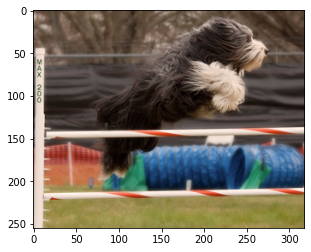

Real Caption: furry black and white dog jumps over bar during an agility test
Predicted Caption: the dog is jumping over low yellow and white bar in an obstacle course
BLEU-1 score: 42.857142857142854
BLEU-2 score: 18.15682598006407
BLEU-3 score: 1.8181398598601008e-91
BLEU-4 score: 6.356121367760845e-153


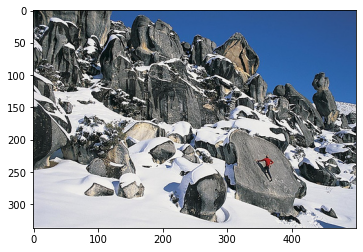

Real Caption: man in red climbs rock in field of snow cliffs and fallen boulders
Predicted Caption: person doing tricks on the mountain
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


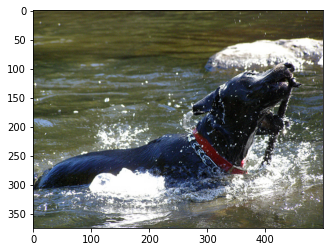

Real Caption: black dog with red collar retrieving stick from deep water
Predicted Caption: black dog is playing in some water
BLEU-1 score: 27.91881675133095
BLEU-2 score: 17.410441154600917
BLEU-3 score: 1.493615157227752e-91
BLEU-4 score: 5.023587836914362e-153


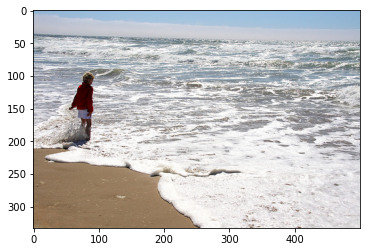

Real Caption: woman in red jacket stands on the beach facing the water as it covers her feet
Predicted Caption: girl in black is watching the sunset
BLEU-1 score: 7.898658475130412
BLEU-2 score: 2.2042435261229696e-153
BLEU-3 score: 4.861917956276235e-184
BLEU-4 score: 3.682245099646241e-230


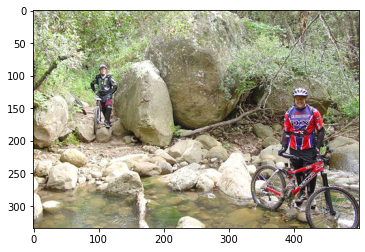

Real Caption: two biker walk across the ground
Predicted Caption: two people in bike gear stand with bicycles near rocky
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229


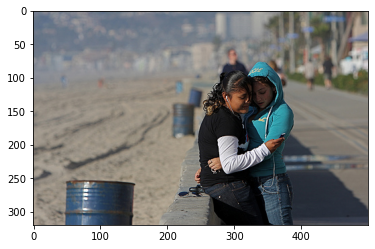

Real Caption: two young women are embracing at the side of road and looking at an player
Predicted Caption: two people with hats on stand near street
BLEU-1 score: 5.210775245981356
BLEU-2 score: 2.1984649726039663e-153
BLEU-3 score: 5.721000570633737e-184
BLEU-4 score: 4.515731954963997e-230


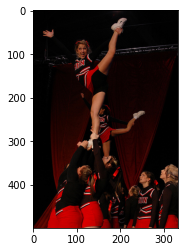

Real Caption: two cheerleaders in red an black are standing on the shoulders of other cheerleaders in front of red curtain
Predicted Caption: the girl in the blue dress is kicking up the person in red and black
BLEU-1 score: 25.530944612154954
BLEU-2 score: 11.81853084405639
BLEU-3 score: 1.2630387661659017e-91
BLEU-4 score: 4.487950221566228e-153


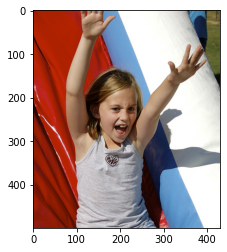

Real Caption: girl with extended arms goes down slide
Predicted Caption: boy in red shirt with his arms raised as he looks toward the camera
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229


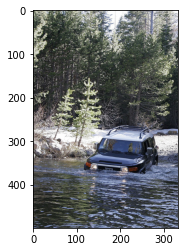

Real Caption: car is partially submerged in lake
Predicted Caption: red suv splashing in water in the woods
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


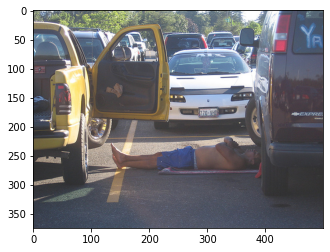

Real Caption: man in blue shorts lays down outside in parking lot
Predicted Caption: young man in blue shirt and into the air
BLEU-1 score: 29.827977227145652
BLEU-2 score: 25.831786022211855
BLEU-3 score: 23.684339170440293
BLEU-4 score: 3.6100344298273085e-76


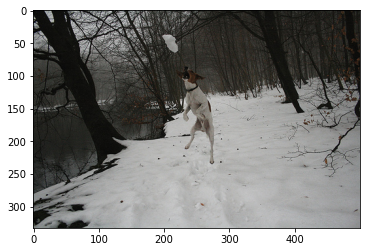

Real Caption: brown and white dog jumps in the air to catch snowball
Predicted Caption: dog jumps high while another dog watches
BLEU-1 score: 16.13480348593598
BLEU-2 score: 12.323159716256498
BLEU-3 score: 1.1464873458118043e-91
BLEU-4 score: 3.9350396855261313e-153


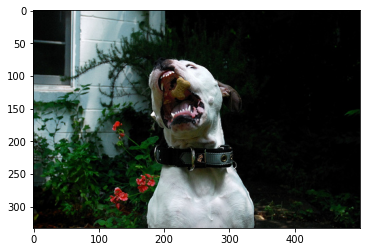

Real Caption: white dog catching treat in his mouth
Predicted Caption: dog catching in its mouth
BLEU-1 score: 53.62560368285115
BLEU-2 score: 29.97762379232956
BLEU-3 score: 2.0931219659557178e-91
BLEU-4 score: 6.686701276748014e-153


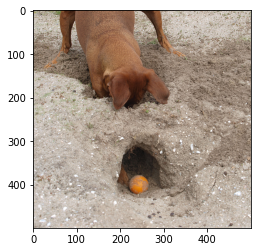

Real Caption: dog digging for his ball in the sand
Predicted Caption: brown dog digging for white ball that is covered in sand
BLEU-1 score: 54.54545454545454
BLEU-2 score: 33.02891295379082
BLEU-3 score: 26.61116056713934
BLEU-4 score: 4.0524962413351e-76


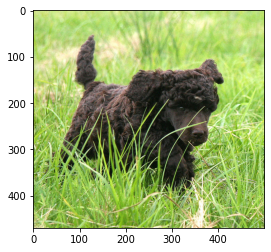

Real Caption: the black dog is walking through the tall grass
Predicted Caption: black dog is running in the grass
BLEU-1 score: 53.67694950537757
BLEU-2 score: 36.668337256566886
BLEU-3 score: 30.14741462123022
BLEU-4 score: 4.28743102682343e-76


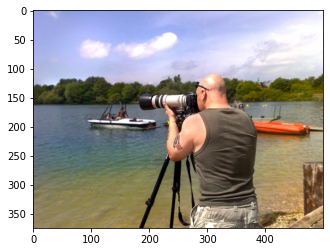

Real Caption: man wearing tank top <unk> into camera that on tripod
Predicted Caption: man and woman stand on the rocks by the water
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229


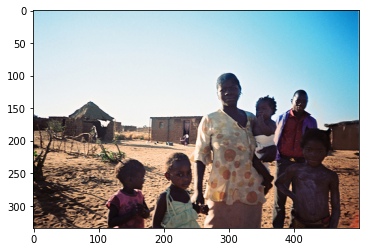

Real Caption: an african family are standing in front of some makeshift houses
Predicted Caption: girl and young boy with black jackets and five children in crowd
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230


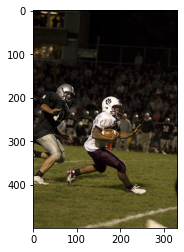

Real Caption: football player is running with football
Predicted Caption: the football player is being tackled by the player
BLEU-1 score: 33.33333333333333
BLEU-2 score: 28.867513459481287
BLEU-3 score: 26.467700653516886
BLEU-4 score: 4.034282314146679e-76


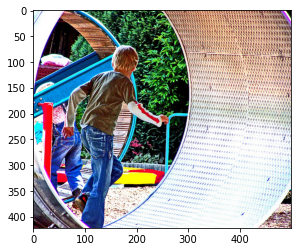

Real Caption: boy run through big wheel
Predicted Caption: boy is at the top of slide with his eyes closed
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229


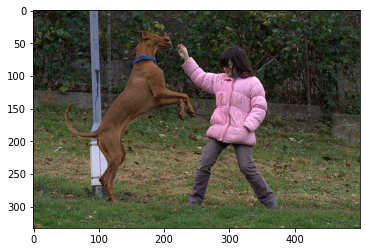

Real Caption: woman is standing in front of dog that standing on its hind legs
Predicted Caption: brown dog is jumping up at black dog in front of green fence
BLEU-1 score: 38.46153846153847
BLEU-2 score: 25.318484177091666
BLEU-3 score: 21.362142852538657
BLEU-4 score: 3.374479444311902e-76


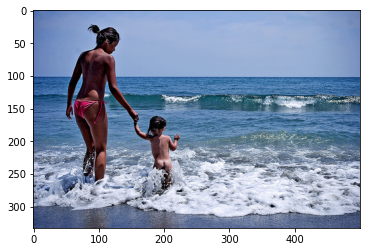

Real Caption: woman and naked child wade into the ocean
Predicted Caption: boy and woman walk into the ocean
BLEU-1 score: 61.91984998215584
BLEU-2 score: 42.29931028018367
BLEU-3 score: 34.777002193640136
BLEU-4 score: 4.945830350570697e-76


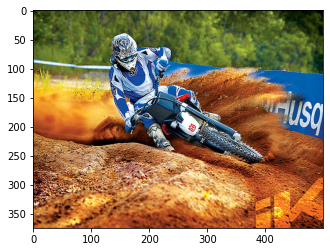

Real Caption: dirt biker participates in race
Predicted Caption: man in red rides motorcycle up dirt bike bike up hill
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229


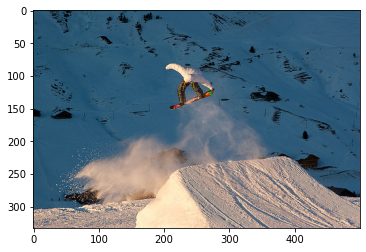

Real Caption: snowboarder is leaping of jump in the mountains
Predicted Caption: snowboarder in midair
BLEU-1 score: 12.591706855837456
BLEU-2 score: 2.3003951838113042e-153
BLEU-3 score: 4.283069726958402e-184
BLEU-4 score: 3.1092910180411375e-230


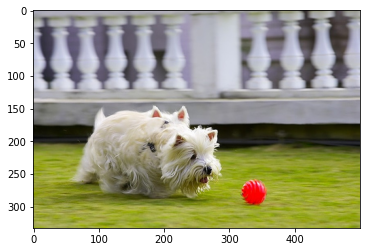

Real Caption: two small white dogs chasing after red ball
Predicted Caption: two west highland terriers chase red ball
BLEU-1 score: 37.1519099892935
BLEU-2 score: 23.168286407366764
BLEU-3 score: 1.9875719080152112e-91
BLEU-4 score: 6.68494960953009e-153


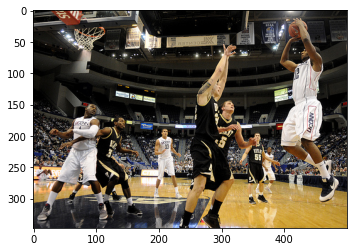

Real Caption: basketball players leap for the ball while the crowd watches
Predicted Caption: basketball player in white uniform is making jump shot against team wearing black uniforms
BLEU-1 score: 7.1428571428571415
BLEU-2 score: 3.986650812853149e-153
BLEU-3 score: 1.1602945388103906e-183
BLEU-4 score: 9.418382295637229e-230


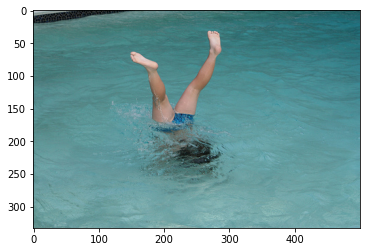

Real Caption: child stands upside down in pool
Predicted Caption: child is doing handstand in pool
BLEU-1 score: 50.0
BLEU-2 score: 31.6227766016838
BLEU-3 score: 2.536315813271983e-91
BLEU-4 score: 8.38826642100846e-153


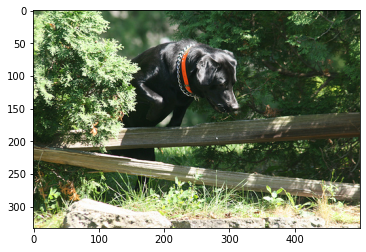

Real Caption: black dog with red collar is climbing over fence posts
Predicted Caption: dog is climbing over fence outside in the grass
BLEU-1 score: 49.71329537857609
BLEU-2 score: 40.84363993014518
BLEU-3 score: 38.38418051488286
BLEU-4 score: 28.24099048856541


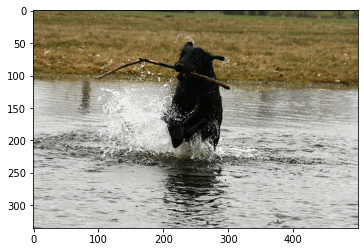

Real Caption: black dog runs through the water carrying stick
Predicted Caption: dog fetching stick in the lake
BLEU-1 score: 35.826565528689464
BLEU-2 score: 7.55774771366971e-153
BLEU-3 score: 1.490502925709351e-183
BLEU-4 score: 1.0977058971259434e-229


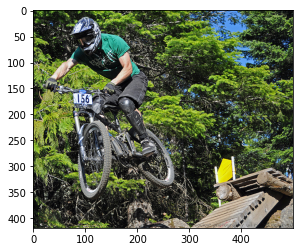

Real Caption: cyclist in green shirt doing trick on wooden ramp
Predicted Caption: bicyclist wearing helment riding down steep ramp
BLEU-1 score: 10.735389901075512
BLEU-2 score: 4.236810678370506e-153
BLEU-3 score: 1.073477903059106e-183
BLEU-4 score: 8.416851712392763e-230


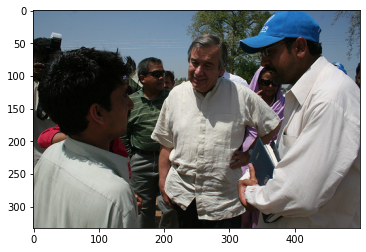

Real Caption: three men converse in crowd
Predicted Caption: two men are standing in crowd holding book
BLEU-1 score: 37.5
BLEU-2 score: 23.145502494313785
BLEU-3 score: 2.1032131949153637e-91
BLEU-4 score: 7.176381577237209e-153


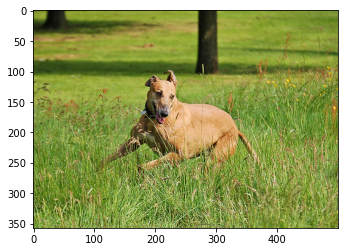

Real Caption: brown <unk> dog runs through high grass
Predicted Caption: dog is running through tall grass
BLEU-1 score: 42.324086244530704
BLEU-2 score: 8.92842395935524e-153
BLEU-3 score: 1.7608211516934517e-183
BLEU-4 score: 1.2967862918337585e-229


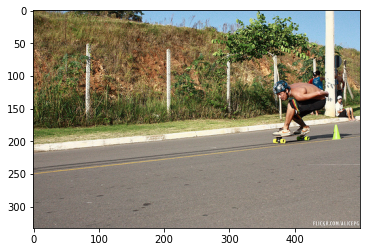

Real Caption: shirtless man skateboards down sunny roadside
Predicted Caption: man with no shirt speed skateboards downhill
BLEU-1 score: 28.57142857142857
BLEU-2 score: 7.973301625706313e-153
BLEU-3 score: 1.7586776545063734e-183
BLEU-4 score: 1.331960397810445e-229


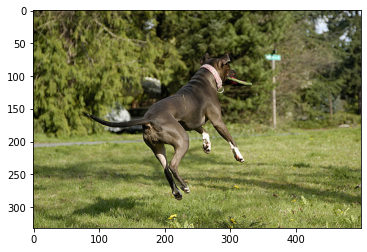

Real Caption: dog is jumping in the air to catch an item
Predicted Caption: dog leaps high to catch ball
BLEU-1 score: 25.6708559516296
BLEU-2 score: 16.23567485864776
BLEU-3 score: 1.3021879578069072e-91
BLEU-4 score: 4.3066795795519947e-153


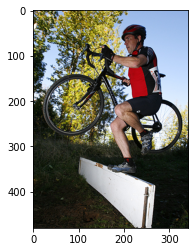

Real Caption: man walks over small sign carrying his bicycle
Predicted Caption: man is jumping over low wall holding bicycle
BLEU-1 score: 37.5
BLEU-2 score: 9.134564559628536e-153
BLEU-3 score: 1.9081654987219002e-183
BLEU-4 score: 1.4256605770826505e-229


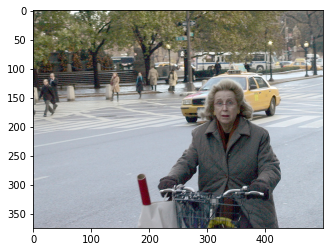

Real Caption: an older woman with blond hair rides bicycle down the street
Predicted Caption: an older man with is riding bicycle and red skater bicycle by building
BLEU-1 score: 30.769230769230766
BLEU-2 score: 16.012815380508712
BLEU-3 score: 1.6861024029072228e-91
BLEU-4 score: 5.969061643530969e-153


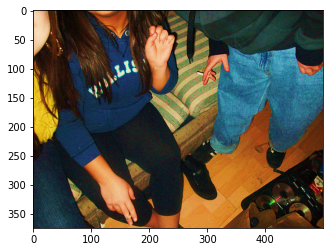

Real Caption: hands and feet of several people holding cigarettes
Predicted Caption: two young men with small blue jeans performing near wall
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


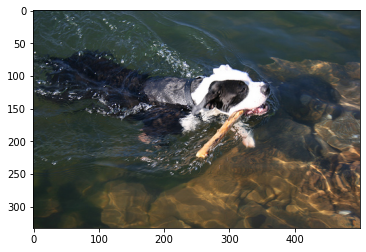

Real Caption: black and white dog with stick in its mouth is swimming
Predicted Caption: dog is standing in the water
BLEU-1 score: 21.729910425353914
BLEU-2 score: 4.5840057067137364e-153
BLEU-3 score: 9.040357228341029e-184
BLEU-4 score: 6.657922819542466e-230


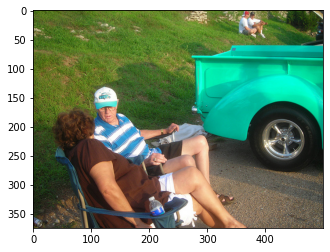

Real Caption: an older couple chats near bright colored car
Predicted Caption: two people are sitting in chairs near flowers
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


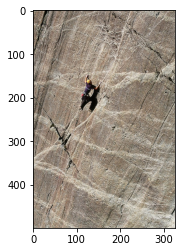

Real Caption: climber ascending mountain
Predicted Caption: man is sitting on the side of huge rock face
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


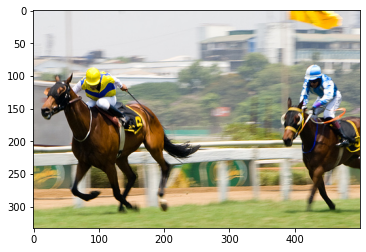

Real Caption: the jockey wearing yellow hat <unk> out the jockey wearing blue
Predicted Caption: two jockeys in numbered shirts race past each other
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


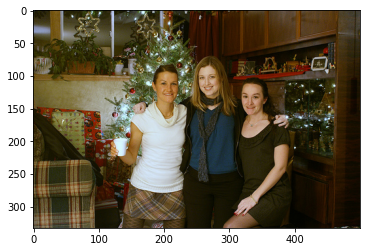

Real Caption: three women standing next to each other are smiling in front of christmas tree
Predicted Caption: three women are posing for picture beside dresser in front of christmas tree
BLEU-1 score: 56.98222022414253
BLEU-2 score: 46.88786183641642
BLEU-3 score: 41.68616286192493
BLEU-4 score: 31.843164596791894


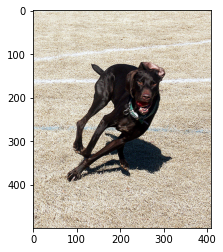

Real Caption: black dog is running very fast on light brown ground
Predicted Caption: black dog running on grass
BLEU-1 score: 29.430355293715387
BLEU-2 score: 16.4520687596796
BLEU-3 score: 1.1487296906805026e-91
BLEU-4 score: 3.6697394677640927e-153


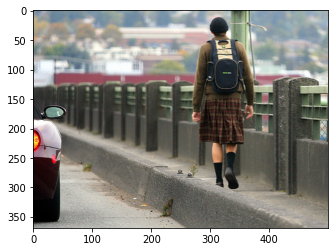

Real Caption: person walks near fence
Predicted Caption: woman walks with backpack while talking on the sidewalk
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


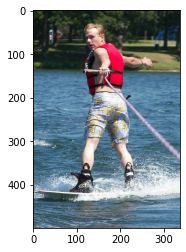

Real Caption: man in swim trunks and red life vest jet skiing
Predicted Caption: the person in the red shorts and blue shorts is above the water
BLEU-1 score: 23.076923076923077
BLEU-2 score: 7.165741990418252e-153
BLEU-3 score: 1.6495292825393885e-183
BLEU-4 score: 1.2627076138080563e-229


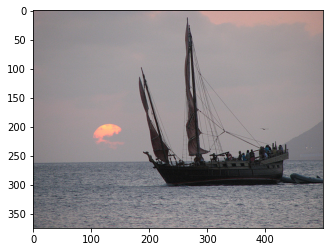

Real Caption: sailboat in the water
Predicted Caption: closeup of boat on the water
BLEU-1 score: 33.33333333333333
BLEU-2 score: 25.819888974716115
BLEU-3 score: 2.2458252053838132e-91
BLEU-4 score: 7.57965434483665e-153


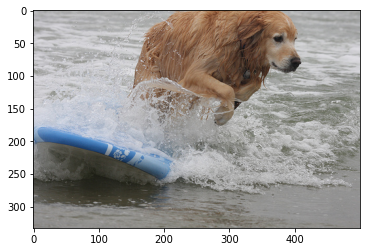

Real Caption: golden retriever jumps off of blue surfboard in the water
Predicted Caption: dog is being by man in the water
BLEU-1 score: 29.20502936517768
BLEU-2 score: 25.492239569397107
BLEU-3 score: 23.279302911889214
BLEU-4 score: 3.477086386303713e-76


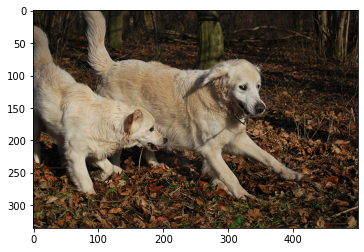

Real Caption: two light tan dogs of the same breed but different size are running in the woods
Predicted Caption: two dogs running around in the ground
BLEU-1 score: 19.74664618782603
BLEU-2 score: 9.538536312716417
BLEU-3 score: 7.388238798462879e-92
BLEU-4 score: 2.422276827743267e-153


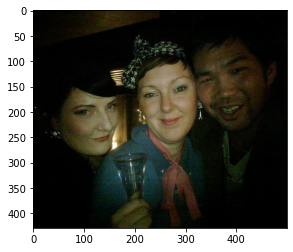

Real Caption: two women and man pose for the camera
Predicted Caption: girl in black is laughing and holding glass
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


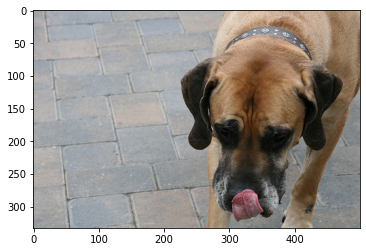

Real Caption: dog licks his nose
Predicted Caption: brown dog with black collar is licking nose
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229


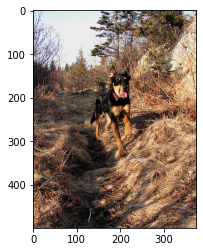

Real Caption: brown and black dog running on trail in the woods
Predicted Caption: dog with red collar runs in forest in the middle of winter
BLEU-1 score: 25.0
BLEU-2 score: 15.075567228888179
BLEU-3 score: 1.6261759223357467e-91
BLEU-4 score: 5.791739854583281e-153


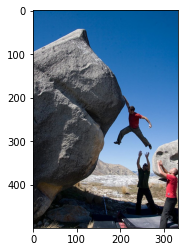

Real Caption: man in the red shirt tried to hang onto the rock while three others watched
Predicted Caption: man in red shirt is jumping off of rock into the sand
BLEU-1 score: 38.94003915357025
BLEU-2 score: 23.48172712620745
BLEU-3 score: 1.9196051367135764e-91
BLEU-4 score: 6.378968006113944e-153


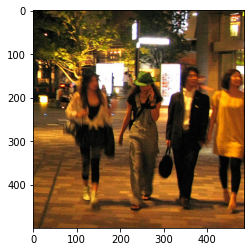

Real Caption: four people are walking on sidewalk
Predicted Caption: group of people are standing on street in front of store
BLEU-1 score: 27.27272727272727
BLEU-2 score: 16.514456476895408
BLEU-3 score: 1.7175994813661398e-91
BLEU-4 score: 6.061838450024688e-153


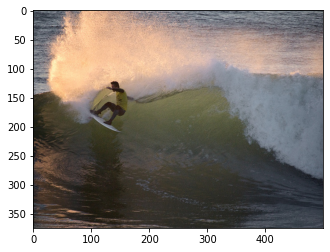

Real Caption: surfer in yellow shirt is riding wave that is reflecting sunlight
Predicted Caption: man in black is surfing on white surfboard
BLEU-1 score: 17.182231969774307
BLEU-2 score: 5.126037622123983e-153
BLEU-3 score: 1.1612566946930451e-183
BLEU-4 score: 8.853864984883468e-230


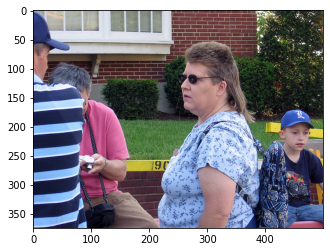

Real Caption: three adults and one child are waiting outside of building perhaps school
Predicted Caption: girl in sunglasses and boy with sunglasses sit in hats
BLEU-1 score: 8.18730753077982
BLEU-2 score: 3.862009336171134e-153
BLEU-3 score: 1.0508670198626023e-183
BLEU-4 score: 8.387826279040936e-230


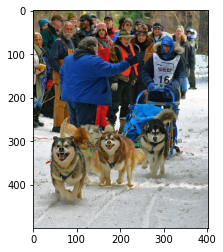

Real Caption: participant in dog sled race passes onlookers
Predicted Caption: the dog is pulling the sled through the snow behind the dogs
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


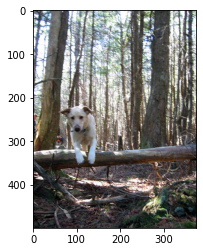

Real Caption: brown dog is jumping over fallen tree in the woods
Predicted Caption: light colored dog leaps over log in the forest
BLEU-1 score: 39.77063630286087
BLEU-2 score: 21.09156496639261
BLEU-3 score: 1.9026838655964305e-91
BLEU-4 score: 6.480360213743594e-153


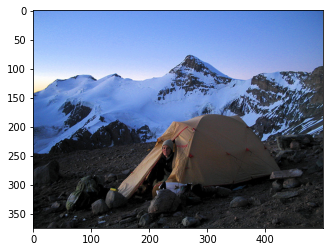

Real Caption: man sits in his tent on mountain
Predicted Caption: hiker pokes his head out of tent high in the mountains
BLEU-1 score: 27.27272727272727
BLEU-2 score: 7.789982830837433e-153
BLEU-3 score: 1.7343040158223243e-183
BLEU-4 score: 1.3165594234639305e-229


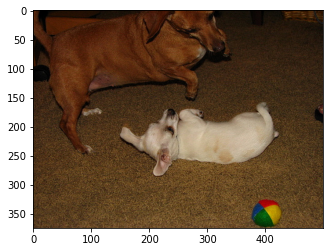

Real Caption: big brown dog plays with small white dog near ball
Predicted Caption: brown dog is jumping on top of long colorful rug
BLEU-1 score: 20.0
BLEU-2 score: 14.9071198499986
BLEU-3 score: 1.6152493512830776e-91
BLEU-4 score: 5.75929185611095e-153


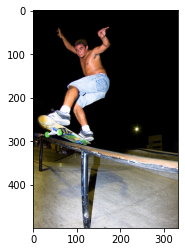

Real Caption: skateboarder doing trick on handrail
Predicted Caption: boy is riding skateboard on rail
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


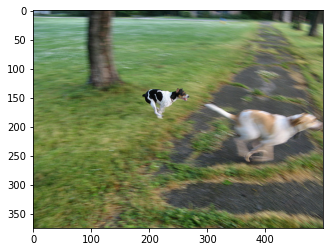

Real Caption: two dogs are running across grassy path
Predicted Caption: dog runs behind another at park
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


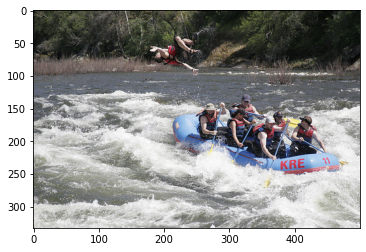

Real Caption: six people are riding in raft on white water whilst the <unk> person has been flung out of the boat into the air
Predicted Caption: the man is in the water and about to be pulled off the raft
BLEU-1 score: 22.53377247539056
BLEU-2 score: 5.134456907544674e-153
BLEU-3 score: 1.044297680678439e-183
BLEU-4 score: 7.750412497763064e-230


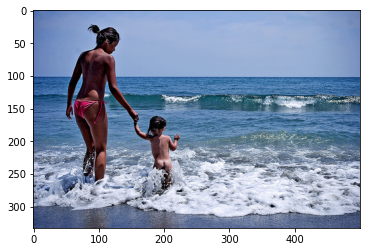

Real Caption: woman and naked child wade into the ocean
Predicted Caption: boy and woman walk into the ocean
BLEU-1 score: 61.91984998215584
BLEU-2 score: 42.29931028018367
BLEU-3 score: 34.777002193640136
BLEU-4 score: 4.945830350570697e-76


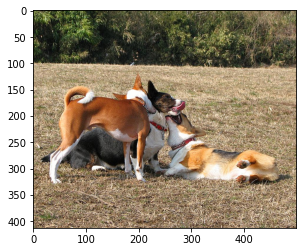

Real Caption: three dogs affectionately playing
Predicted Caption: two dogs one with its tongue sticking out
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


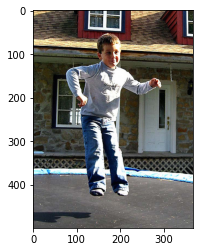

Real Caption: boy jumping on trampoline
Predicted Caption: boy is jumping on trampoline
BLEU-1 score: 80.0
BLEU-2 score: 63.245553203367585
BLEU-3 score: 54.63634277011612
BLEU-4 score: 7.380245217279165e-76


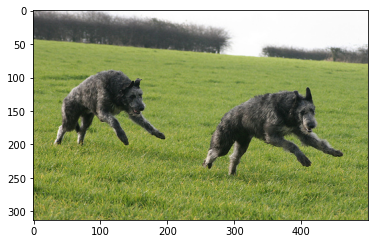

Real Caption: two grey dogs running in green grass
Predicted Caption: two dogs are wrestling on grassy field
BLEU-1 score: 28.57142857142857
BLEU-2 score: 7.973301625706313e-153
BLEU-3 score: 1.7586776545063734e-183
BLEU-4 score: 1.331960397810445e-229


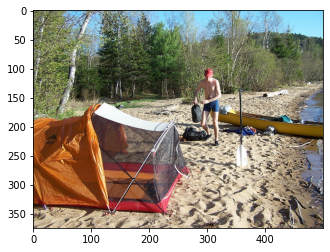

Real Caption: man is camping on beach shore
Predicted Caption: tent rests on the shore and man and canoe are in the background
BLEU-1 score: 23.076923076923077
BLEU-2 score: 7.165741990418252e-153
BLEU-3 score: 1.6495292825393885e-183
BLEU-4 score: 1.2627076138080563e-229


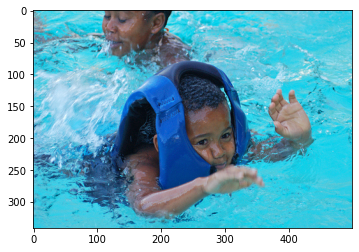

Real Caption: kid wearing life jacket in swimming pool
Predicted Caption: two kids in swimming pool
BLEU-1 score: 40.21920276213836
BLEU-2 score: 36.71494099616211
BLEU-3 score: 33.59558495175079
BLEU-4 score: 4.6038197862150135e-76


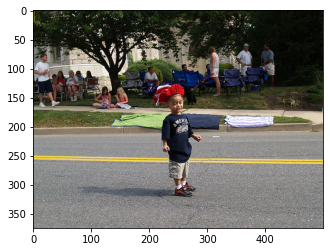

Real Caption: small child with funny red hat stands in the road
Predicted Caption: boy wearing red hat holding box
BLEU-1 score: 17.113903967753068
BLEU-2 score: 13.256373011140136
BLEU-3 score: 1.1530451067989366e-91
BLEU-4 score: 3.8915242969889024e-153


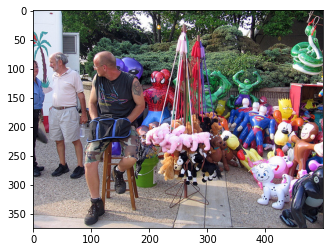

Real Caption: vendor sells children toys as visitors walk by
Predicted Caption: man sits on stool beside toys
BLEU-1 score: 11.942188509563156
BLEU-2 score: 4.3634676769543673e-153
BLEU-3 score: 1.072004124838459e-183
BLEU-4 score: 8.34076112986429e-230


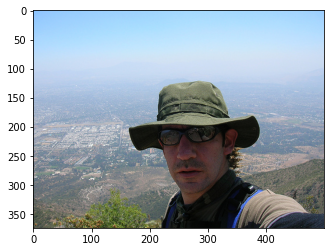

Real Caption: man with green hate and sunglasses on high up peak
Predicted Caption: man is taking self portrait
BLEU-1 score: 7.357588823428847
BLEU-2 score: 2.454102690856474e-153
BLEU-3 score: 5.813279118387829e-184
BLEU-4 score: 4.481994719908145e-230


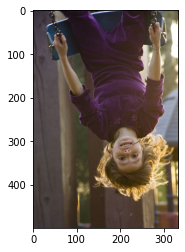

Real Caption: young child in purple shirt hanging upside down on swing
Predicted Caption: child is upside down on swing
BLEU-1 score: 42.78475991938267
BLEU-2 score: 36.304072644520666
BLEU-3 score: 33.872897504486694
BLEU-4 score: 27.58512992979459


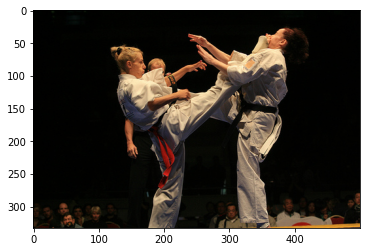

Real Caption: two women participate in martial arts match
Predicted Caption: two men are kicking each other in martial arts uniforms
BLEU-1 score: 40.0
BLEU-2 score: 29.81423969999719
BLEU-3 score: 25.92550634024553
BLEU-4 score: 3.965294799986402e-76


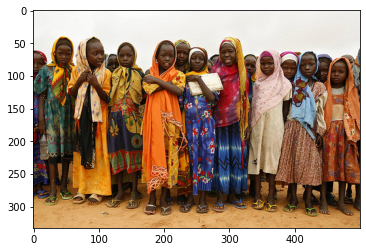

Real Caption: group of
Predicted Caption: group of young women covering her hair and young man standing in group
BLEU-1 score: 15.384615384615385
BLEU-2 score: 11.322770341445958
BLEU-3 score: 1.36954071726339e-91
BLEU-4 score: 5.019362538473706e-153


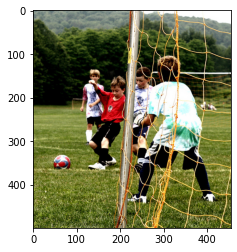

Real Caption: four children run along grassy field playing soccer
Predicted Caption: young boys playing soccer on field
BLEU-1 score: 35.826565528689464
BLEU-2 score: 22.65870956238665
BLEU-3 score: 1.8173496937128004e-91
BLEU-4 score: 6.0104555320873e-153


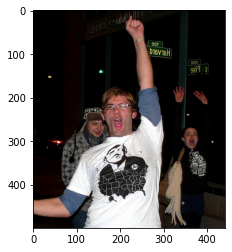

Real Caption: man is raising his hand in the air and has with the united states on it
Predicted Caption: man is standing on his hands in the air with his hands up in the air with trick
BLEU-1 score: 50.0
BLEU-2 score: 29.70442628930023
BLEU-3 score: 21.01148301534595
BLEU-4 score: 3.328255793132717e-76


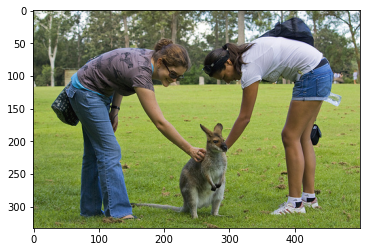

Real Caption: two girls pet small kangaroo in grassy field
Predicted Caption: two young girls each other on the ground in front of fence
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229


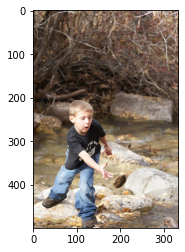

Real Caption: boy in creek throwing rock
Predicted Caption: boy tosses rock across river
BLEU-1 score: 40.0
BLEU-2 score: 9.434137710479516e-153
BLEU-3 score: 1.9454705288851736e-183
BLEU-4 score: 1.4488496539373276e-229


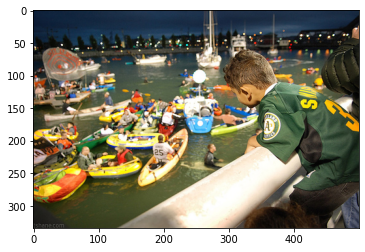

Real Caption: boy in green shirt is looking down at many inflatable boats
Predicted Caption: two people are in baby pool
BLEU-1 score: 7.243303475117973
BLEU-2 score: 2.646576928737885e-153
BLEU-3 score: 6.502033690529349e-184
BLEU-4 score: 5.058927350602078e-230


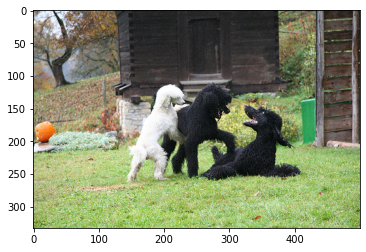

Real Caption: white dog and two black dogs playing
Predicted Caption: white dog and black poodles are playing on the grass
BLEU-1 score: 50.0
BLEU-2 score: 33.33333333333333
BLEU-3 score: 27.720448401281438
BLEU-4 score: 4.1927887725759644e-76


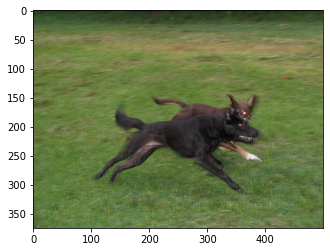

Real Caption: two dogs running on grass
Predicted Caption: two dogs are running on the grass
BLEU-1 score: 71.42857142857143
BLEU-2 score: 48.795003647426654
BLEU-3 score: 3.290247306760209e-91
BLEU-4 score: 1.0419812236391601e-152


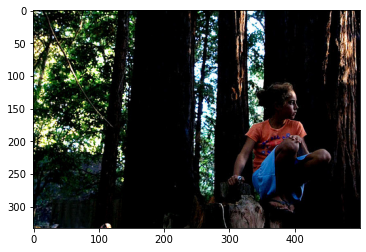

Real Caption: little girl squats on tree stump in the woods
Predicted Caption: girl in white is sitting on the edge of tree in the woods
BLEU-1 score: 46.15384615384615
BLEU-2 score: 27.735009811261456
BLEU-3 score: 22.563121849503307
BLEU-4 score: 3.531848763573142e-76


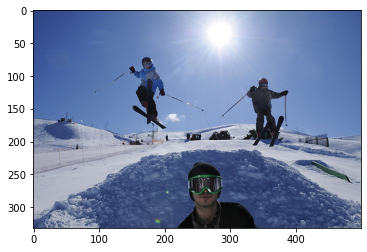

Real Caption: two people are going over <unk> jump while one looks into the camera
Predicted Caption: two people wearing skis on snowy hill
BLEU-1 score: 12.124938447912854
BLEU-2 score: 9.260574705706839
BLEU-3 score: 8.61559207175724e-92
BLEU-4 score: 2.9570929710230013e-153


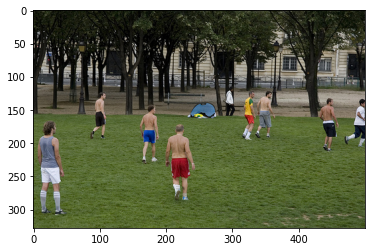

Real Caption: group of men are standing around during sports game in park
Predicted Caption: people playing soccer in field
BLEU-1 score: 6.02388423824404
BLEU-2 score: 2.009249344215622e-153
BLEU-3 score: 4.759510390450173e-184
BLEU-4 score: 3.669546912321932e-230


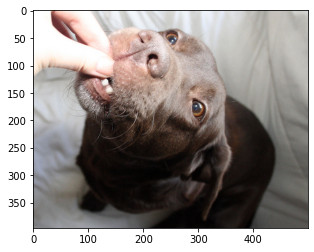

Real Caption: person touches dog tooth
Predicted Caption: dog is chewing on someone finger
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


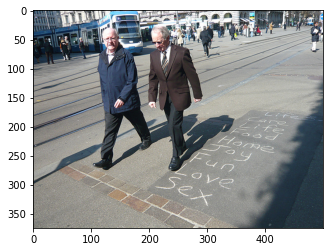

Real Caption: two men walk through city with words on the street
Predicted Caption: two men are walking down city street
BLEU-1 score: 37.225089001774606
BLEU-2 score: 20.10384577463796
BLEU-3 score: 1.6282471743409526e-91
BLEU-4 score: 5.398196439422726e-153


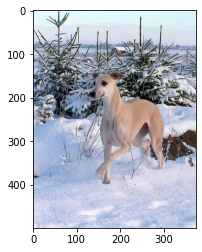

Real Caption: dog stands in the white snow
Predicted Caption: white dog runs by pine trees in the snow
BLEU-1 score: 55.55555555555556
BLEU-2 score: 26.352313834736496
BLEU-3 score: 2.2734980277612575e-91
BLEU-4 score: 7.657404561915943e-153


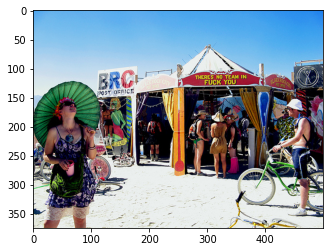

Real Caption: many people are walking along the beach on clear day
Predicted Caption: beach with people standing on the sand
BLEU-1 score: 37.225089001774606
BLEU-2 score: 7.345595085009947e-153
BLEU-3 score: 1.4104868374560027e-183
BLEU-4 score: 1.0318643420027732e-229


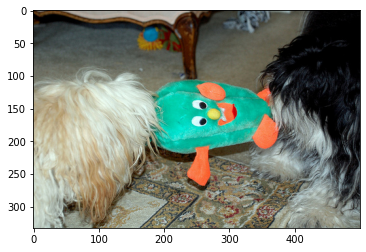

Real Caption: two dogs fight over green stuffed toy
Predicted Caption: two dogs sharing toy
BLEU-1 score: 35.427491455576096
BLEU-2 score: 23.618327637050733
BLEU-3 score: 1.5771190245453664e-91
BLEU-4 score: 4.982374365655583e-153


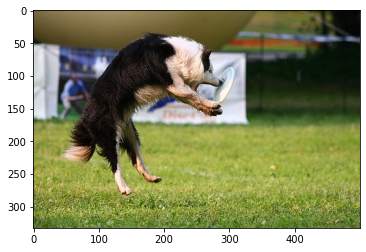

Real Caption: dog jumping to catch frisbee
Predicted Caption: dog jumps in the air to catch frisbee
BLEU-1 score: 50.0
BLEU-2 score: 37.79644730092272
BLEU-3 score: 32.585561793662905
BLEU-4 score: 4.7975972319129444e-76


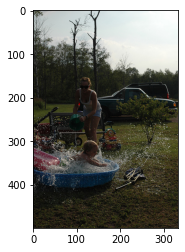

Real Caption: little kid splashes around in the kiddie pool while lady watches
Predicted Caption: woman is throwing bucket of water over baby in the paddling pool
BLEU-1 score: 25.0
BLEU-2 score: 15.075567228888179
BLEU-3 score: 1.6261759223357467e-91
BLEU-4 score: 5.791739854583281e-153


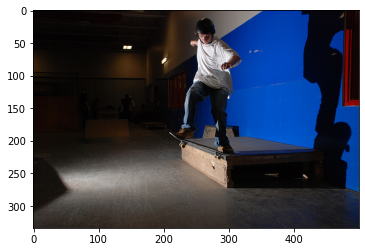

Real Caption: child performs skateboard tricks on wooden platform
Predicted Caption: the skateboarder is doing trick off the side of the ramp
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


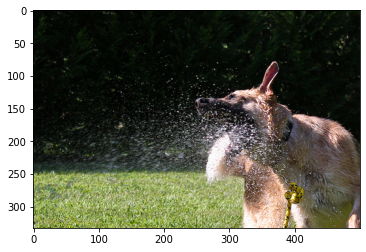

Real Caption: brown dog is splashing water in yard
Predicted Caption: brown dog is running through water carrying ball in its mouth
BLEU-1 score: 45.45454545454545
BLEU-2 score: 30.15113445777636
BLEU-3 score: 25.19471451241524
BLEU-4 score: 3.8719283242189534e-76


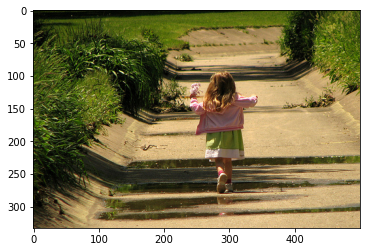

Real Caption: little girl walking down the sidewalk
Predicted Caption: little girl holding flowers is walking away down path
BLEU-1 score: 44.44444444444444
BLEU-2 score: 23.570226039551585
BLEU-3 score: 2.1262855015914923e-91
BLEU-4 score: 7.241926111174567e-153


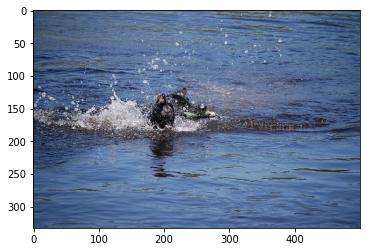

Real Caption: someone splashing in the water
Predicted Caption: dog fetching stick in the water
BLEU-1 score: 50.0
BLEU-2 score: 44.721359549995796
BLEU-3 score: 40.70905315369044
BLEU-4 score: 5.775353993361614e-76


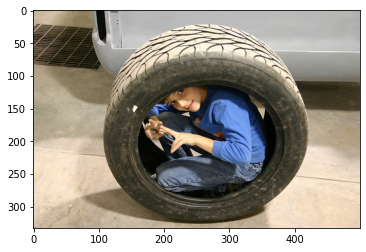

Real Caption: the child is sitting in large truck tire
Predicted Caption: boy crouched and holding tire
BLEU-1 score: 10.976232721880528
BLEU-2 score: 3.6610910047675876e-153
BLEU-3 score: 8.672393363093234e-184
BLEU-4 score: 6.686350417856737e-230


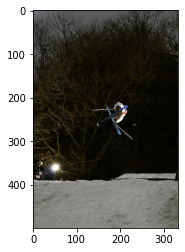

Real Caption: skier makes jump with his skis crossed
Predicted Caption: person is in the air on skis
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229


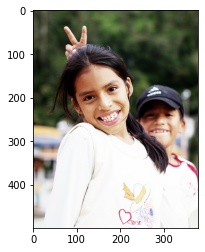

Real Caption: smiling girl with white shirt with boy standing behind making rabbit ears behind her head
Predicted Caption: girl in red sweater and boy in red shirt are standing in crowd
BLEU-1 score: 26.3816590510905
BLEU-2 score: 7.09440535973772e-153
BLEU-3 score: 1.541796710956087e-183
BLEU-4 score: 1.16338362758752e-229


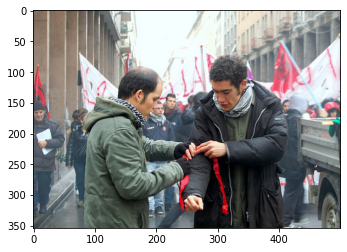

Real Caption: one man helps another <unk> red ribbon to his <unk> in the midst of large group of people
Predicted Caption: man is giving tie bag in front of crowd
BLEU-1 score: 12.262648039048077
BLEU-2 score: 3.168232950523297e-153
BLEU-3 score: 6.776037495668201e-184
BLEU-4 score: 5.092529201164552e-230


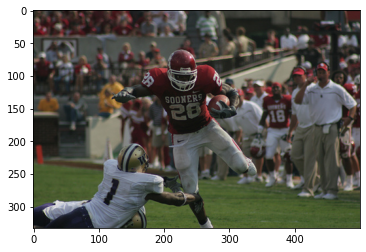

Real Caption: the sooner football player carrying the ball is trying to avoid being tackled
Predicted Caption: football player is trying to tackle another player
BLEU-1 score: 33.453839282436896
BLEU-2 score: 27.702410779900845
BLEU-3 score: 21.061608869051955
BLEU-4 score: 3.004969387521094e-76


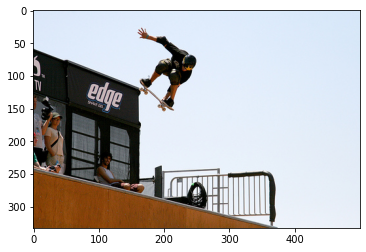

Real Caption: skateboarder does trick off brown ramp while three other people watch
Predicted Caption: skateboarder is performing stunt
BLEU-1 score: 4.344348586261129
BLEU-2 score: 1.2960652804577518e-153
BLEU-3 score: 2.936116733117454e-184
BLEU-4 score: 2.2386076440877335e-230


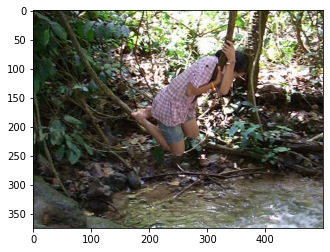

Real Caption: girl <unk> pink swings over creek
Predicted Caption: girl swings on vine over water
BLEU-1 score: 50.0
BLEU-2 score: 1.0547686614863434e-152
BLEU-3 score: 2.0801644027471386e-183
BLEU-4 score: 1.5319719891192392e-229


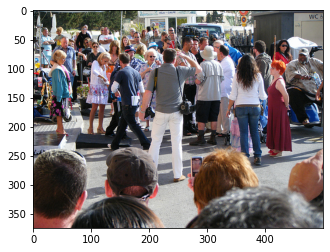

Real Caption: crowd is gathering in town square
Predicted Caption: crowd of people are gathered together in front of
BLEU-1 score: 22.22222222222222
BLEU-2 score: 7.031791076575252e-153
BLEU-3 score: 1.6309584783156365e-183
BLEU-4 score: 1.2508498911928378e-229


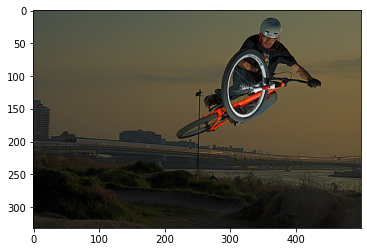

Real Caption: bmx rider gets some air
Predicted Caption: man on an orange bike
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


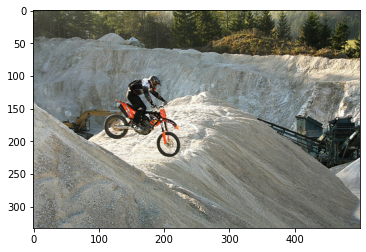

Real Caption: man is jumping rock on an orange dirt bike
Predicted Caption: man rides his dirt bike over hill
BLEU-1 score: 32.206169703226536
BLEU-2 score: 20.084075461628778
BLEU-3 score: 1.7229821612226873e-91
BLEU-4 score: 5.795035077445241e-153


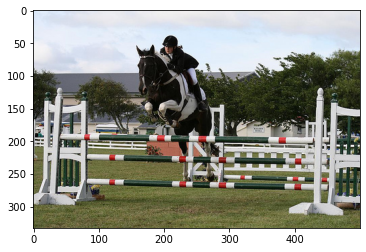

Real Caption: person jumping horse over fence
Predicted Caption: man in jeans is jumping brown horse over wooden fence
BLEU-1 score: 40.0
BLEU-2 score: 21.08185106778919
BLEU-3 score: 1.9886052149911738e-91
BLEU-4 score: 6.848990852664275e-153


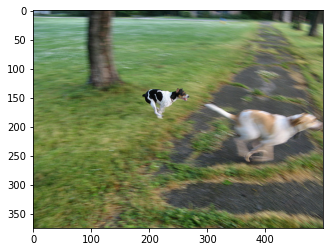

Real Caption: two dogs are running quickly through park
Predicted Caption: dog runs behind another at park
BLEU-1 score: 14.108028748176901
BLEU-2 score: 5.154827976372712e-153
BLEU-3 score: 1.2664232355128374e-183
BLEU-4 score: 9.853445011990207e-230


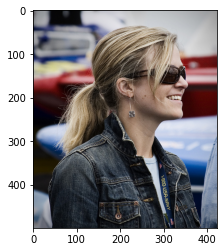

Real Caption: blonde woman wearing sunglasses and <unk> earrings smiles
Predicted Caption: boy wearing sunglasses looks straight ahead
BLEU-1 score: 23.88437701912631
BLEU-2 score: 18.500758885923073
BLEU-3 score: 1.609204077733313e-91
BLEU-4 score: 5.431059661402121e-153


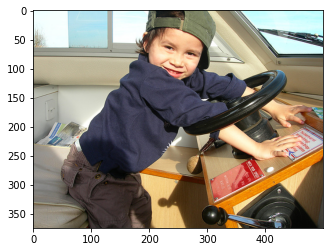

Real Caption: child in green cap sits at boats controls
Predicted Caption: boy wearing red shirt
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


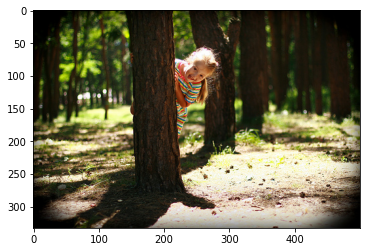

Real Caption: young girl wearing striped dress peeks out from behind tree
Predicted Caption: young girl peeking out from behind tree in forest
BLEU-1 score: 59.655954454291305
BLEU-2 score: 51.66357204442371
BLEU-3 score: 44.19653965753659
BLEU-4 score: 31.762152032055834


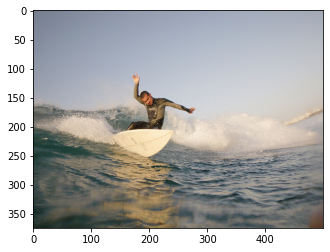

Real Caption: surfer in wetsuit riding wave
Predicted Caption: man is riding surfboard along wave
BLEU-1 score: 33.33333333333333
BLEU-2 score: 8.612150057732662e-153
BLEU-3 score: 1.8419179593432007e-183
BLEU-4 score: 1.384292958842266e-229


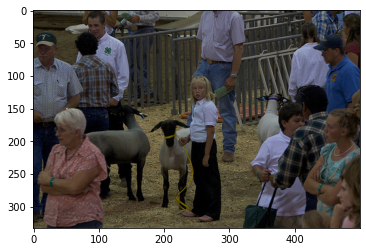

Real Caption: girl holding sheep by the leash in busy fair setting
Predicted Caption: girl in black shirt is in hat and hat
BLEU-1 score: 19.885318151430436
BLEU-2 score: 6.29232312294398e-153
BLEU-3 score: 1.4594457704885681e-183
BLEU-4 score: 1.1193096620723277e-229


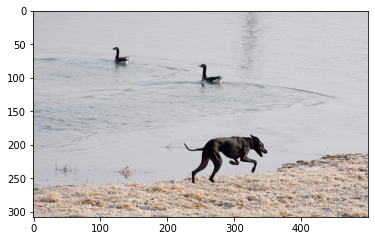

Real Caption: black dog running along the sandy shoreline of body of water while two ducks swim nearby
Predicted Caption: dog and two birds
BLEU-1 score: 2.4893534183931973
BLEU-2 score: 5.251383946170092e-154
BLEU-3 score: 1.0356528733596866e-184
BLEU-4 score: 7.627239415993209e-231


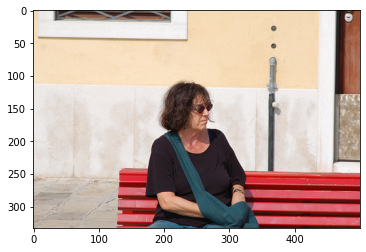

Real Caption: the woman in the brown shirt is sitting on bright red bench
Predicted Caption: woman in black shirt is sitting on red bench
BLEU-1 score: 63.691672051003486
BLEU-2 score: 53.40709061500022
BLEU-3 score: 41.25086006547749
BLEU-4 score: 28.897629773533684


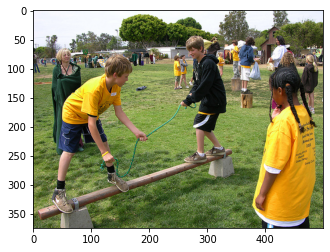

Real Caption: two boys holding green rope and competing against each other on balancing rod while others look on
Predicted Caption: two young boys are playing with two clear rail
BLEU-1 score: 9.135828677937498
BLEU-2 score: 2.8908557358588535e-153
BLEU-3 score: 6.705070757424583e-184
BLEU-4 score: 5.142397638489538e-230


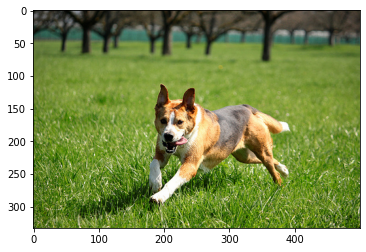

Real Caption: brown dog is running on the grass in front of some trees
Predicted Caption: dog is running through the grass
BLEU-1 score: 30.656620097620195
BLEU-2 score: 26.013004751144447
BLEU-3 score: 19.714171123011663
BLEU-4 score: 2.671585816994813e-76


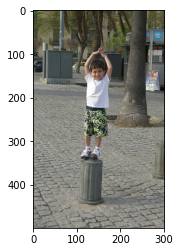

Real Caption: young man wearing white and green and black shorts standing on stump
Predicted Caption: boy looks at something in his hand with his hand
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


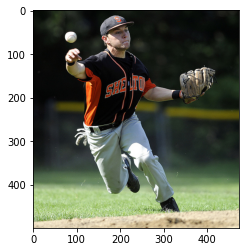

Real Caption: man playing baseball
Predicted Caption: the boy is wearing red and yellow shirt and holding ball
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


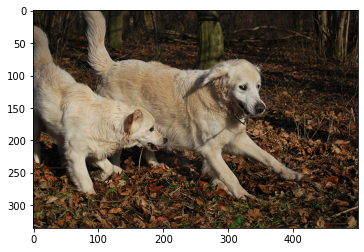

Real Caption: two light tan dogs of the same breed but different size are running in the woods
Predicted Caption: two dogs running around in the ground
BLEU-1 score: 19.74664618782603
BLEU-2 score: 9.538536312716417
BLEU-3 score: 7.388238798462879e-92
BLEU-4 score: 2.422276827743267e-153


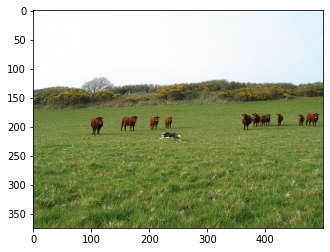

Real Caption: black and white dog running in the grass where there are some cows
Predicted Caption: black and white dog is running through cow field
BLEU-1 score: 35.62113269055304
BLEU-2 score: 29.265746847750883
BLEU-3 score: 27.503467169629918
BLEU-4 score: 20.235553926673695


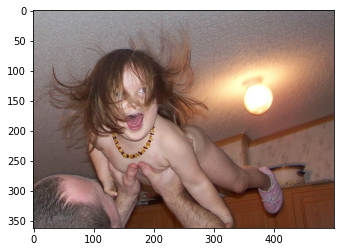

Real Caption: man is spinning little girl in the air above his head
Predicted Caption: child is smiling and holding plate above his head
BLEU-1 score: 35.588329018524796
BLEU-2 score: 26.6912467638936
BLEU-3 score: 23.104041197656937
BLEU-4 score: 3.4712915060210914e-76


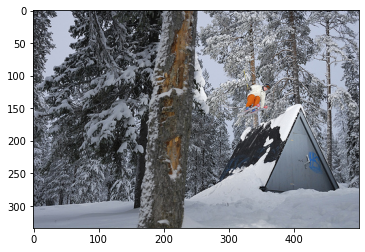

Real Caption: person ski jumps off an frame shack
Predicted Caption: the skier wearing orange pants is jumping over the wooden roof
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


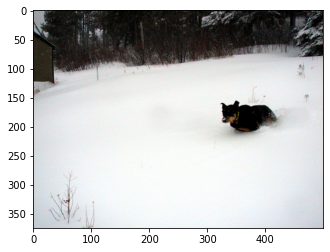

Real Caption: the dog runs in the deep snow
Predicted Caption: dog is running through snow covered grass
BLEU-1 score: 28.57142857142857
BLEU-2 score: 7.973301625706313e-153
BLEU-3 score: 1.7586776545063734e-183
BLEU-4 score: 1.331960397810445e-229


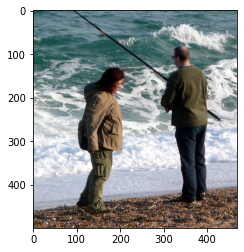

Real Caption: man and woman are standing on shore while the man fishes in the choppy water
Predicted Caption: man and woman are at the end of the ocean edge
BLEU-1 score: 37.91694154902975
BLEU-2 score: 28.119956455120914
BLEU-3 score: 25.720234608121785
BLEU-4 score: 18.04966158344719


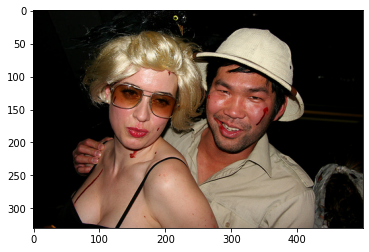

Real Caption: blond lady and an asian guy have blood stains on their face and neck
Predicted Caption: man and woman dressed in costume pose for picture
BLEU-1 score: 6.375038008193696
BLEU-2 score: 2.8528323383676753e-153
BLEU-3 score: 7.600798053186184e-184
BLEU-4 score: 6.034940380417626e-230


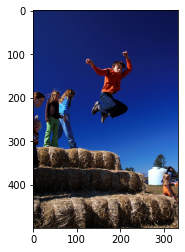

Real Caption: boy wearing orange jumps from <unk>
Predicted Caption: boy in blue shirt jumps off raft
BLEU-1 score: 28.57142857142857
BLEU-2 score: 7.973301625706313e-153
BLEU-3 score: 1.7586776545063734e-183
BLEU-4 score: 1.331960397810445e-229


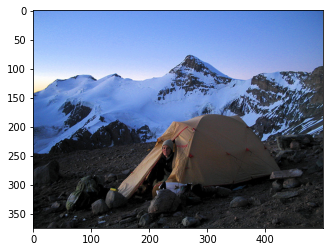

Real Caption: man sits in his tent on mountain
Predicted Caption: hiker pokes his head out of tent high in the mountains
BLEU-1 score: 27.27272727272727
BLEU-2 score: 7.789982830837433e-153
BLEU-3 score: 1.7343040158223243e-183
BLEU-4 score: 1.3165594234639305e-229


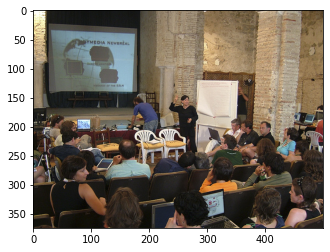

Real Caption: classroom of students watching presentation
Predicted Caption: man is giving presentation in front of lot of people
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229


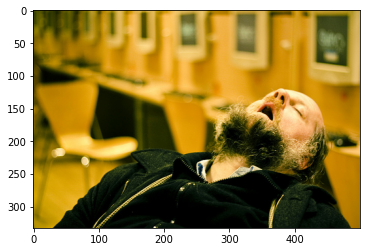

Real Caption: man with beard sleeps in chair computer banks behind him
Predicted Caption: man is lying in the street face of blue building
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229


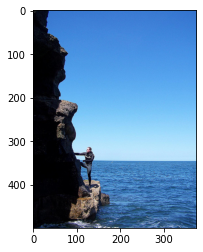

Real Caption: man admires rock formation on the water
Predicted Caption: man and woman are climbing rock at the ocean
BLEU-1 score: 33.33333333333333
BLEU-2 score: 8.612150057732662e-153
BLEU-3 score: 1.8419179593432007e-183
BLEU-4 score: 1.384292958842266e-229


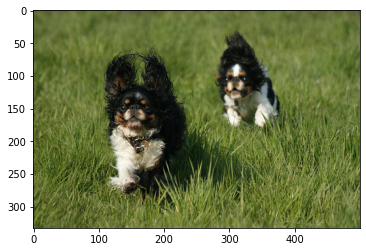

Real Caption: two black brown and white dogs running in green grass with ears up on heads
Predicted Caption: two dogs run through field
BLEU-1 score: 5.413411329464508
BLEU-2 score: 1.2767716991409542e-153
BLEU-3 score: 2.6329080505515765e-184
BLEU-4 score: 1.9608047828287652e-230


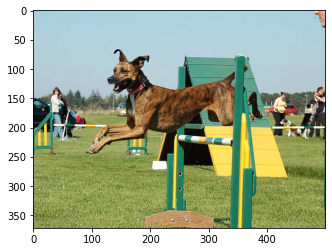

Real Caption: brown dog jumping over hurdle
Predicted Caption: dog is jumping over hurdle
BLEU-1 score: 80.0
BLEU-2 score: 63.245553203367585
BLEU-3 score: 54.63634277011612
BLEU-4 score: 7.380245217279165e-76


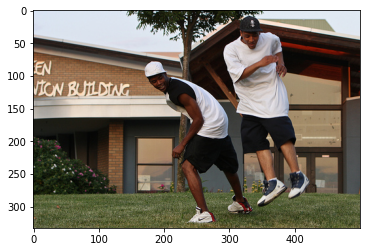

Real Caption: two men dressed in street clothes horse around in front of building
Predicted Caption: two young men around on the grass in front the of union building
BLEU-1 score: 53.84615384615385
BLEU-2 score: 21.182963643408087
BLEU-3 score: 1.9943223756365232e-91
BLEU-4 score: 6.865395738677859e-153


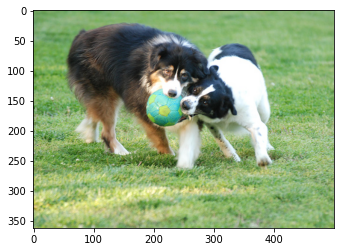

Real Caption: black dog and black dog are fighting over soccer ball
Predicted Caption: two dogs play with blue and green ball
BLEU-1 score: 19.470019576785123
BLEU-2 score: 5.808561601872144e-153
BLEU-3 score: 1.3158762272049197e-183
BLEU-4 score: 1.0032743411283238e-229


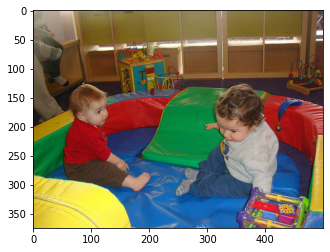

Real Caption: two babies playing inside of colorful padded enclosure
Predicted Caption: two young children are playing with toys
BLEU-1 score: 24.767939992862335
BLEU-2 score: 6.911878967366998e-153
BLEU-3 score: 1.5245587914760605e-183
BLEU-4 score: 1.154647032204335e-229


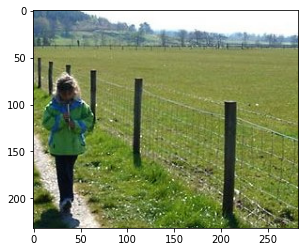

Real Caption: young girl in parka playing flute while walking by fenced in field
Predicted Caption: girl wearing green jacket and blue jeans walks beside fence
BLEU-1 score: 8.18730753077982
BLEU-2 score: 3.862009336171134e-153
BLEU-3 score: 1.0508670198626023e-183
BLEU-4 score: 8.387826279040936e-230


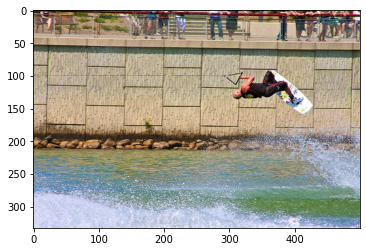

Real Caption: bald man in black wetsuit flips leaps in the air on surfboard holds on to waterskiing handle
Predicted Caption: wakeboarder soars through the air
BLEU-1 score: 3.6287181315765005
BLEU-2 score: 2.868753570633078
BLEU-3 score: 2.300893794756061e-92
BLEU-4 score: 7.60966361360193e-154


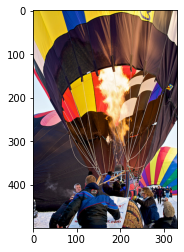

Real Caption: group of people climb into hot air balloon
Predicted Caption: many people playing with purple ring
BLEU-1 score: 11.942188509563156
BLEU-2 score: 4.3634676769543673e-153
BLEU-3 score: 1.072004124838459e-183
BLEU-4 score: 8.34076112986429e-230


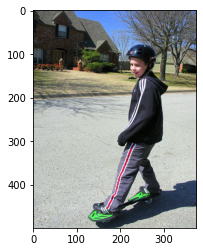

Real Caption: there is boy with helmet and stripe down the side of his pants riding on skateboard
Predicted Caption: boy wearing helmet rides his on the street
BLEU-1 score: 22.992465073215147
BLEU-2 score: 4.338281636081978e-153
BLEU-3 score: 8.182314761483195e-184
BLEU-4 score: 5.959143532253851e-230


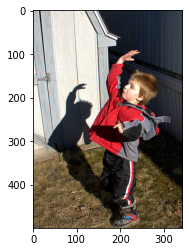

Real Caption: child shadow is shown behind him
Predicted Caption: young boy in costume giving handstand
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


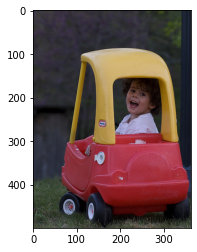

Real Caption: there is child in red and yellow toy car
Predicted Caption: child in fuzzy red hat standing in large yellow kayak
BLEU-1 score: 40.0
BLEU-2 score: 21.08185106778919
BLEU-3 score: 1.9886052149911738e-91
BLEU-4 score: 6.848990852664275e-153


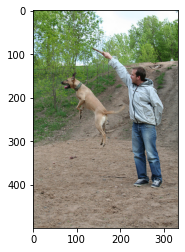

Real Caption: man is holding stick beside jumping dog
Predicted Caption: man is throwing stick for his dog
BLEU-1 score: 57.14285714285714
BLEU-2 score: 30.860669992418384
BLEU-3 score: 2.499462007255115e-91
BLEU-4 score: 8.286571670851009e-153


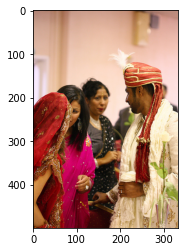

Real Caption: scene at an indian wedding
Predicted Caption: group of people are wearing formal attire
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


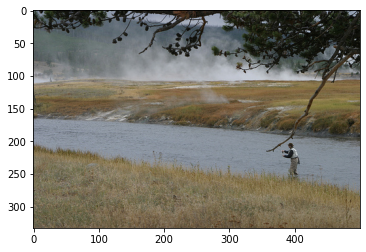

Real Caption: man is fly fishing <unk> in stream
Predicted Caption: the man is standing in the river next to smoking grass
BLEU-1 score: 27.27272727272727
BLEU-2 score: 16.514456476895408
BLEU-3 score: 1.7175994813661398e-91
BLEU-4 score: 6.061838450024688e-153


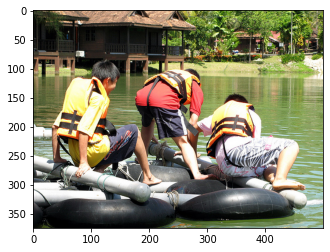

Real Caption: three boys wearing yellow <unk> on raft on the water
Predicted Caption: the three boys who are wearing life jackets are looking in the water
BLEU-1 score: 38.46153846153847
BLEU-2 score: 25.318484177091666
BLEU-3 score: 2.2195551978722937e-91
BLEU-4 score: 7.505697654413981e-153


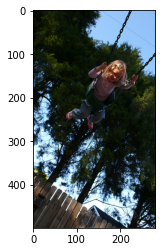

Real Caption: girl wearing pink swings on swing
Predicted Caption: little girl in pink is swinging on wooden fence
BLEU-1 score: 33.33333333333333
BLEU-2 score: 8.612150057732662e-153
BLEU-3 score: 1.8419179593432007e-183
BLEU-4 score: 1.384292958842266e-229


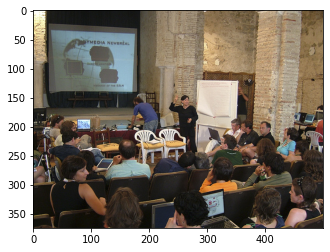

Real Caption: conference is being held that <unk> laptops and big screen <unk>
Predicted Caption: man is giving presentation in front of lot of people
BLEU-1 score: 9.048374180359598
BLEU-2 score: 4.2681804036729734e-153
BLEU-3 score: 1.1613876691169721e-183
BLEU-4 score: 9.269981669466711e-230


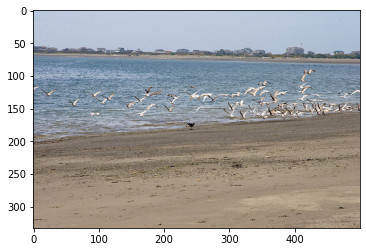

Real Caption: flock of birds flying over shoreline
Predicted Caption: group of birds fly up from the ground
BLEU-1 score: 25.0
BLEU-2 score: 18.898223650461357
BLEU-3 score: 1.8623269155678368e-91
BLEU-4 score: 6.484592771860511e-153


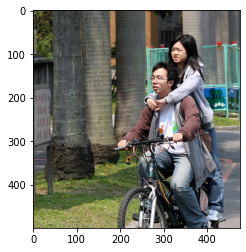

Real Caption: one kid is towing another on his bike
Predicted Caption: man rides bicycle while young girl holds onto the back
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


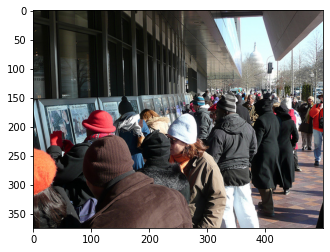

Real Caption: crowd of people in front of memorial in washington <unk>
Predicted Caption: many people are standing on the street in front of large building
BLEU-1 score: 33.33333333333333
BLEU-2 score: 24.618298195866544
BLEU-3 score: 21.614978940479492
BLEU-4 score: 3.4077295621678845e-76


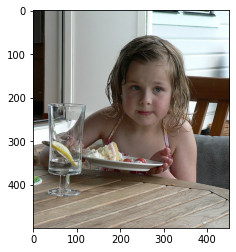

Real Caption: girl wearing halter top eats cake at table
Predicted Caption: the little boy wearing the blue shirt is eating
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


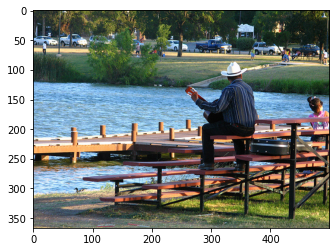

Real Caption: man plays guitar on waterside bleachers
Predicted Caption: man sits on bench and plays guitar
BLEU-1 score: 57.14285714285714
BLEU-2 score: 30.860669992418384
BLEU-3 score: 2.499462007255115e-91
BLEU-4 score: 8.286571670851009e-153


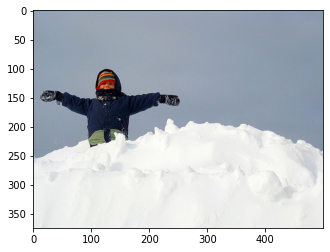

Real Caption: little boy is on top of snow mound
Predicted Caption: the child is standing on top of snowbank with their snowboard
BLEU-1 score: 36.36363636363637
BLEU-2 score: 26.967994498529684
BLEU-3 score: 23.563317641070423
BLEU-4 score: 3.661843723291765e-76


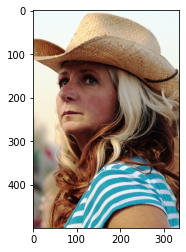

Real Caption: woman wearing hat
Predicted Caption: the smiling woman is wearing black and white shirt
BLEU-1 score: 22.22222222222222
BLEU-2 score: 7.031791076575252e-153
BLEU-3 score: 1.6309584783156365e-183
BLEU-4 score: 1.2508498911928378e-229


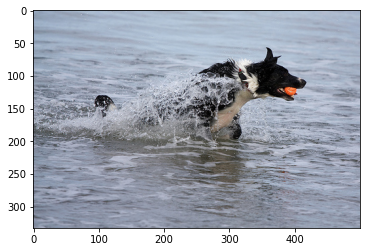

Real Caption: the black dog is running through the water with red ball in its mouth
Predicted Caption: dog jumps out of the water with ball in his mouth
BLEU-1 score: 48.44638824434651
BLEU-2 score: 33.26360808954188
BLEU-3 score: 23.96245335146768
BLEU-4 score: 3.548445858848032e-76


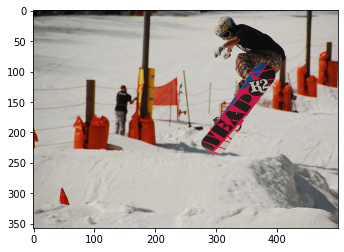

Real Caption: snowboarder makes jump and does trick with his pink blue black board
Predicted Caption: person does trick on snowboard
BLEU-1 score: 9.86387855766426
BLEU-2 score: 7.798080701378897
BLEU-3 score: 6.254477791499576e-92
BLEU-4 score: 2.0685210321540116e-153


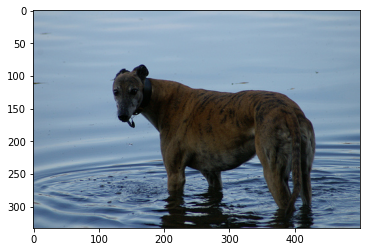

Real Caption: dog in water looking over shoulder at camera
Predicted Caption: the dog is about to cross the steps
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


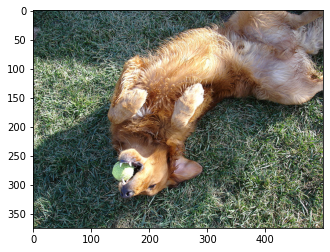

Real Caption: brown dog lies on its back in the grass holding ball in its mouth
Predicted Caption: brown dog with tennis ball its mouth rolling on its back on grassy surface
BLEU-1 score: 57.14285714285714
BLEU-2 score: 41.93139346887673
BLEU-3 score: 28.168855585454473
BLEU-4 score: 4.249232005220522e-76


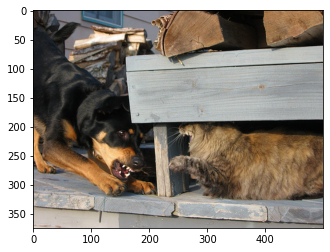

Real Caption: snarling brown and black dog corners brown cat under wooden bench
Predicted Caption: brown and black dog are fighting over some cloth
BLEU-1 score: 35.588329018524796
BLEU-2 score: 32.689967585126034
BLEU-3 score: 32.12360867175481
BLEU-4 score: 23.899976771375066


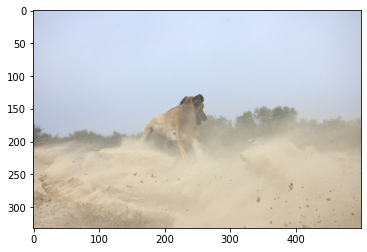

Real Caption: dog kicking up dirt
Predicted Caption: dog is jumping to catch something in its mouth
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


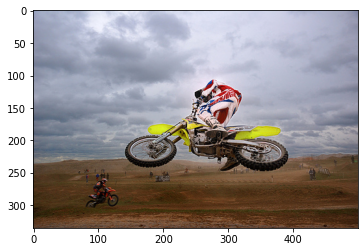

Real Caption: motorcyclist is attempting jump with another motorcyclist nearby as well as onlookers
Predicted Caption: person on motorcycle in midair
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


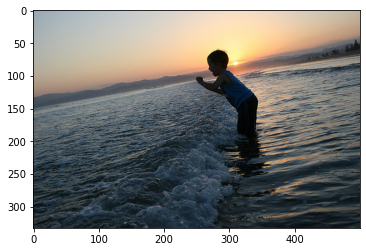

Real Caption: boy plays in the surf at sunset
Predicted Caption: child is playing in the waves with sun on the horizon
BLEU-1 score: 18.181818181818183
BLEU-2 score: 13.483997249264846
BLEU-3 score: 1.5208785072510163e-91
BLEU-4 score: 5.477489369001354e-153


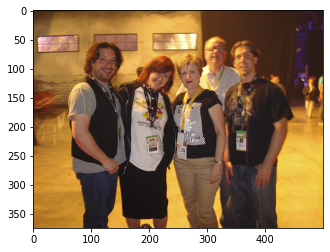

Real Caption: group of people posing in concert area
Predicted Caption: five people are standing in front of an industrial style building
BLEU-1 score: 27.27272727272727
BLEU-2 score: 7.789982830837433e-153
BLEU-3 score: 1.7343040158223243e-183
BLEU-4 score: 1.3165594234639305e-229


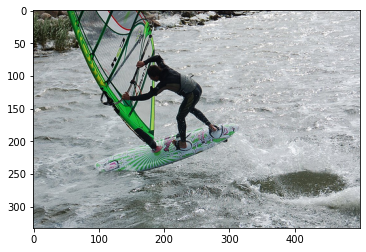

Real Caption: kite surfer begins to fall in the ocean
Predicted Caption: man rides ski over wave
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


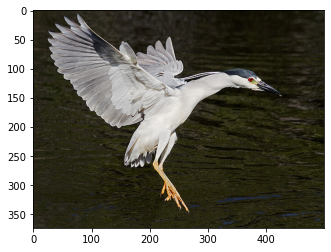

Real Caption: white and black bird stretches its wings in midair
Predicted Caption: bird flies over the water
BLEU-1 score: 8.986579282344431
BLEU-2 score: 2.997447795420392e-153
BLEU-3 score: 7.100355149153815e-184
BLEU-4 score: 5.474320712955125e-230


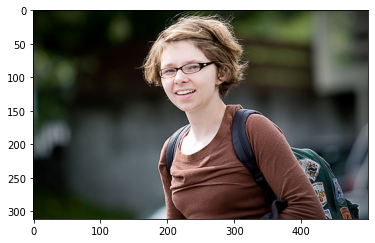

Real Caption: woman wearing brown shirt and glasses smiles for the camera
Predicted Caption: young lady with brown shirt glasses and backpack
BLEU-1 score: 38.94003915357025
BLEU-2 score: 20.814326448603225
BLEU-3 score: 1.7856292781475404e-91
BLEU-4 score: 6.005740822548667e-153


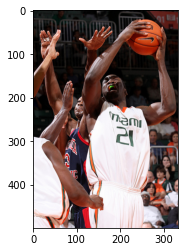

Real Caption: pro basketball player in white miami uniform makes defensive move
Predicted Caption: the man is making miami shot of the man with the basketball and the ball
BLEU-1 score: 13.333333333333334
BLEU-2 score: 5.4468019467172e-153
BLEU-3 score: 1.3992273317570998e-183
BLEU-4 score: 1.1008876702055895e-229


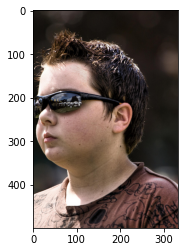

Real Caption: young boy wearing sunglasses and brown shirt with black <unk>
Predicted Caption: boy wearing sunglasses looks straight ahead
BLEU-1 score: 25.6708559516296
BLEU-2 score: 22.960711579379538
BLEU-3 score: 20.9007247887124
BLEU-4 score: 2.965165608665095e-76


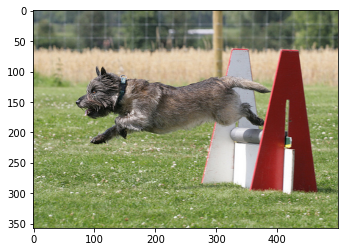

Real Caption: small dog jumping over an obstacle
Predicted Caption: small black dog is jumping over small show in grassy park
BLEU-1 score: 36.36363636363637
BLEU-2 score: 19.06925178491185
BLEU-3 score: 1.8724210775784561e-91
BLEU-4 score: 6.513869329968086e-153


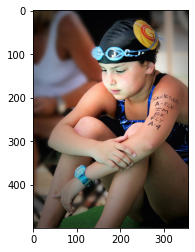

Real Caption: young swimmer sits in bathing suit and waits for the next race
Predicted Caption: young female wearing swimsuit goggles and swimming cap looking into the distance
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229


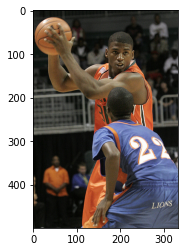

Real Caption: the basketball player in blue is challenging the player in orange for the ball
Predicted Caption: two men in blue and yellow uniforms play basketball with man in white and red uniform while man in white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white
BLEU-1 score: 4.000000000000001
BLEU-2 score: 2.010075630518425
BLEU-3 score: 4.854346451836873e-92
BLEU-4 score: 2.1148443770379257e-153


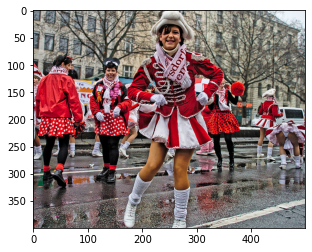

Real Caption: dancer posing for the camera in red and white dress
Predicted Caption: woman in red and black walks down the street
BLEU-1 score: 39.77063630286087
BLEU-2 score: 29.82797722714566
BLEU-3 score: 25.81920660337923
BLEU-4 score: 3.879234451140231e-76


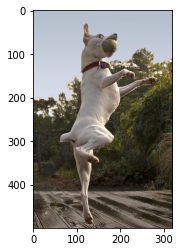

Real Caption: white dog is in the air with ball in its mouth
Predicted Caption: dog is jumping to catch ball and ball in its mouth
BLEU-1 score: 54.54545454545454
BLEU-2 score: 46.70993664969138
BLEU-3 score: 40.334976925681346
BLEU-4 score: 27.901593935858273


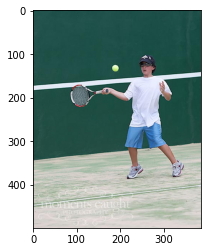

Real Caption: kid in black cap and light blue shorts playing tennis
Predicted Caption: boy dressed in black is doing hit tennis ball
BLEU-1 score: 29.827977227145652
BLEU-2 score: 18.26583106646588
BLEU-3 score: 1.745359983331643e-91
BLEU-4 score: 6.030654703641958e-153


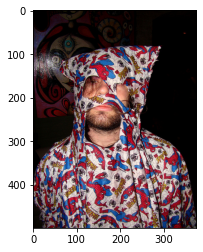

Real Caption: person wearing spiderman print outfit looks up with hood on his face
Predicted Caption: the guy is wearing red and black outfit
BLEU-1 score: 15.163266492815836
BLEU-2 score: 4.5237123240565193e-153
BLEU-3 score: 1.0248054361722373e-183
BLEU-4 score: 7.813508425061864e-230


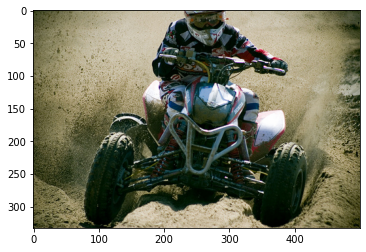

Real Caption: an atv racer <unk> down the track sending dirt flying everywhere
Predicted Caption: man rides dirt bike up dirt road
BLEU-1 score: 8.06740174296799
BLEU-2 score: 3.183867019854334e-153
BLEU-3 score: 8.066942687669913e-184
BLEU-4 score: 6.325072941044999e-230


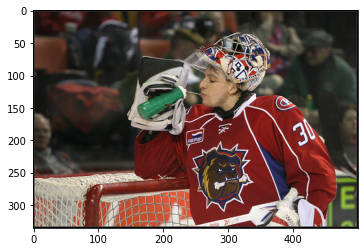

Real Caption: an ice hockey player takes water from green bottle
Predicted Caption: two men are playing street hockey
BLEU-1 score: 10.10884432854389
BLEU-2 score: 3.693595645692774e-153
BLEU-3 score: 9.074319006831119e-184
BLEU-4 score: 7.060301868108111e-230


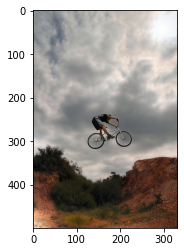

Real Caption: man on bike in midair
Predicted Caption: man is riding his bicycle on hill
BLEU-1 score: 28.57142857142857
BLEU-2 score: 7.973301625706313e-153
BLEU-3 score: 1.7586776545063734e-183
BLEU-4 score: 1.331960397810445e-229


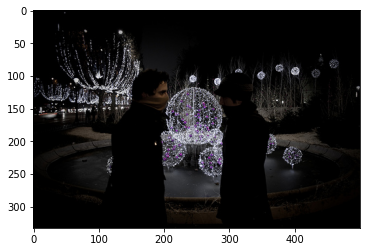

Real Caption: couple standing outside in the dark near some festive lights
Predicted Caption: man is standing in front of fountain at night
BLEU-1 score: 19.885318151430436
BLEU-2 score: 6.29232312294398e-153
BLEU-3 score: 1.4594457704885681e-183
BLEU-4 score: 1.1193096620723277e-229


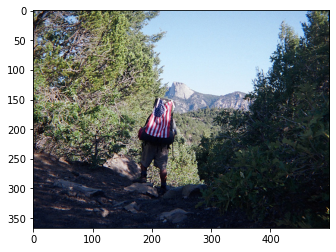

Real Caption: person hikes on mountain
Predicted Caption: hiker is pointing towards the mountains
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


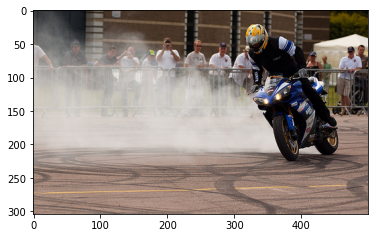

Real Caption: motorcyclist <unk> rubber in circle while crowd watches
Predicted Caption: person in black is on blue motorcycle with smoking back tire and people watching in the background
BLEU-1 score: 5.88235294117647
BLEU-2 score: 3.6178266619513135e-153
BLEU-3 score: 1.0946416849080909e-183
BLEU-4 score: 8.972141065609098e-230


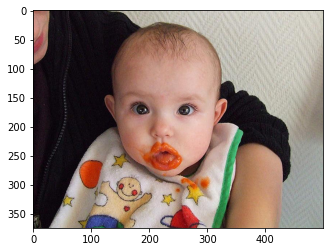

Real Caption: there is baby with lips staring at the camera
Predicted Caption: baby with food all over its mouth
BLEU-1 score: 21.470779802151025
BLEU-2 score: 16.39857894551434
BLEU-3 score: 1.5256446952908055e-91
BLEU-4 score: 5.236405306969006e-153


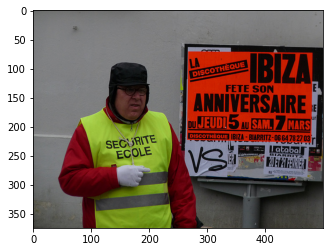

Real Caption: security guard points at sign
Predicted Caption: man is standing with signs on city street
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


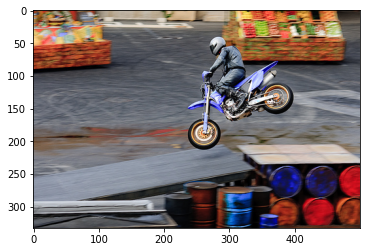

Real Caption: blue motorcycle is jumping over some colored barrels
Predicted Caption: man rides dirt bike over ramp
BLEU-1 score: 11.942188509563156
BLEU-2 score: 4.3634676769543673e-153
BLEU-3 score: 1.072004124838459e-183
BLEU-4 score: 8.34076112986429e-230


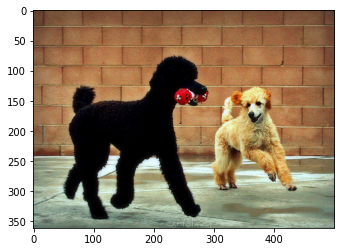

Real Caption: two poodles playing with red toy
Predicted Caption: black dog and white dog are tugging at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at at
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


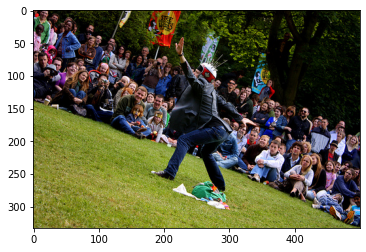

Real Caption: person wearing black coat and helmet with spiky things is posing on the lawn in front of crowd of people
Predicted Caption: man in suit crowd
BLEU-1 score: 0.9157819444367089
BLEU-2 score: 1.931876191493737e-154
BLEU-3 score: 3.8099540029916e-185
BLEU-4 score: 2.805904574036379e-231


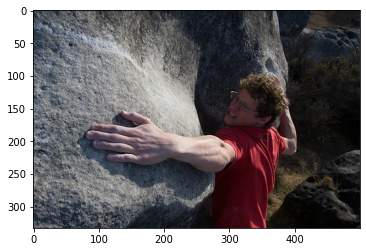

Real Caption: man in red shirt attempts to climb rock
Predicted Caption: man is climbing rocky mountain
BLEU-1 score: 10.976232721880528
BLEU-2 score: 3.6610910047675876e-153
BLEU-3 score: 8.672393363093234e-184
BLEU-4 score: 6.686350417856737e-230


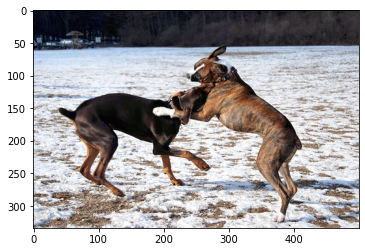

Real Caption: the two dogs are fighting outside in the snow
Predicted Caption: brown dog and black dog are wrestling in the snow
BLEU-1 score: 40.0
BLEU-2 score: 29.81423969999719
BLEU-3 score: 25.92550634024553
BLEU-4 score: 3.965294799986402e-76


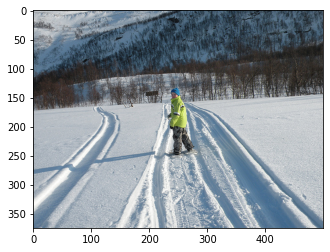

Real Caption: child walking in the snow
Predicted Caption: the child is walking through snow with trees nearby
BLEU-1 score: 44.44444444444444
BLEU-2 score: 9.944454308267121e-153
BLEU-3 score: 2.0079454189758343e-183
BLEU-4 score: 1.4875195904069663e-229


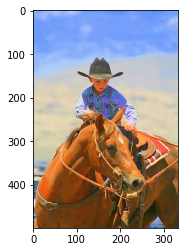

Real Caption: young boy in cowboy hat rides horse
Predicted Caption: boy riding horse
BLEU-1 score: 17.573142541048448
BLEU-2 score: 3.210460101135254e-153
BLEU-3 score: 5.977505328453229e-184
BLEU-4 score: 4.339365177986787e-230


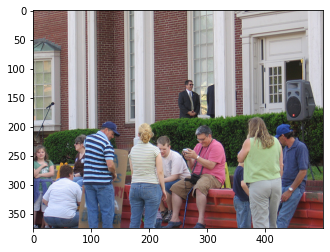

Real Caption: group of people sits outside building
Predicted Caption: group of people are outside brick building taking pictures
BLEU-1 score: 55.55555555555556
BLEU-2 score: 37.2677996249965
BLEU-3 score: 30.85111318413486
BLEU-4 score: 4.583829695130767e-76


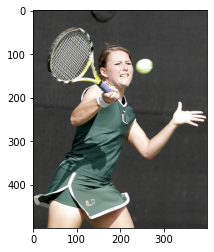

Real Caption: woman in green sport outfit is attempting to hit tennis ball with racket
Predicted Caption: young man in red shirt hits tennis ball
BLEU-1 score: 20.072303569462136
BLEU-2 score: 12.388894728896249
BLEU-3 score: 1.1257688991903872e-91
BLEU-4 score: 3.8412402546293535e-153


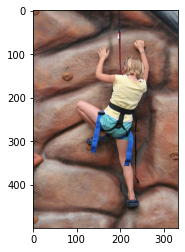

Real Caption: woman in blue shorts and white shirt is indoor rock climbing
Predicted Caption: the girl in the yellow shirt and green shorts is rock
BLEU-1 score: 54.54545454545454
BLEU-2 score: 1.1016699370024175e-152
BLEU-3 score: 2.1351787001213213e-183
BLEU-4 score: 1.5656618337072541e-229


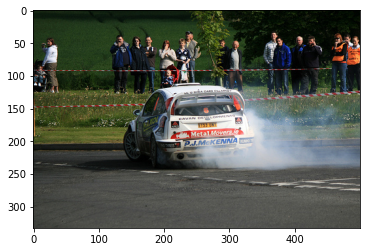

Real Caption: race car blows smoke while it drives
Predicted Caption: race car drives on track while several people watch from behind rope
BLEU-1 score: 33.33333333333333
BLEU-2 score: 17.407765595569778
BLEU-3 score: 1.7727567490939188e-91
BLEU-4 score: 6.223629500679345e-153


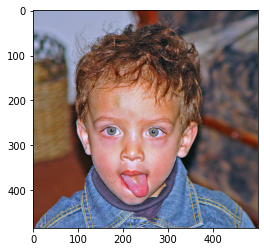

Real Caption: young boy wearing denim shirt sticks out his tongue
Predicted Caption: boy in blue shirt points
BLEU-1 score: 17.973158564688863
BLEU-2 score: 4.239031324788977e-153
BLEU-3 score: 8.741562574645582e-184
BLEU-4 score: 6.510101141652544e-230


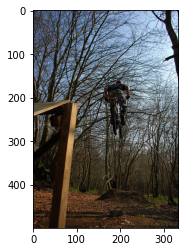

Real Caption: person on bike is making high jump along trail in the woods
Predicted Caption: man rides bicycle over park ramp
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


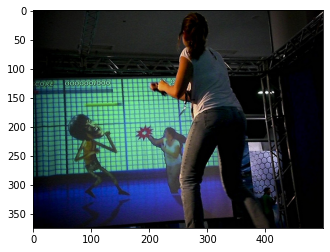

Real Caption: girl is playing video game on life sized screen
Predicted Caption: woman watching herself on big screen while she is playing boxing video game
BLEU-1 score: 46.15384615384615
BLEU-2 score: 27.735009811261456
BLEU-3 score: 2.3443385210458598e-91
BLEU-4 score: 7.855726910762709e-153


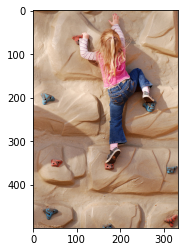

Real Caption: young girl wearing pink shirt climbs rock climb
Predicted Caption: young blond girl is climbing up rock
BLEU-1 score: 37.1519099892935
BLEU-2 score: 8.465288316962106e-153
BLEU-3 score: 1.7217557990773525e-183
BLEU-4 score: 1.2778269941762074e-229


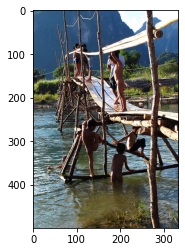

Real Caption: group of young boys one naked play around rickety bridge
Predicted Caption: group of children in the ocean
BLEU-1 score: 17.113903967753068
BLEU-2 score: 13.256373011140136
BLEU-3 score: 1.1530451067989366e-91
BLEU-4 score: 3.8915242969889024e-153


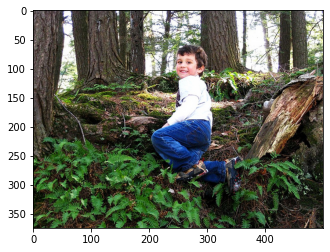

Real Caption: little boy in blue jeans climbs small incline in the woods and turns around to smile
Predicted Caption: boy wearing white shirt climbs on forest hill
BLEU-1 score: 9.196986029286059
BLEU-2 score: 2.743770220260171e-153
BLEU-3 score: 6.215759172786402e-184
BLEU-4 score: 4.739132419722992e-230


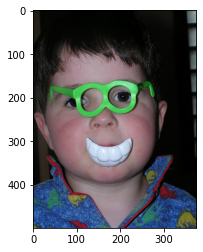

Real Caption: child is posing with toy pieces placed over their mouth and eyes
Predicted Caption: boy has his face wiped out of the blue plastic plastic plastic plastic toy
BLEU-1 score: 7.1428571428571415
BLEU-2 score: 3.986650812853149e-153
BLEU-3 score: 1.1602945388103906e-183
BLEU-4 score: 9.418382295637229e-230


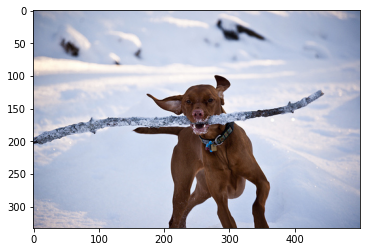

Real Caption: brown dog holding really big stick
Predicted Caption: brown dog runs through snow with snow covered branch in its mouth
BLEU-1 score: 16.666666666666668
BLEU-2 score: 12.309149097933275
BLEU-3 score: 1.4399259176082162e-91
BLEU-4 score: 5.233427736988301e-153


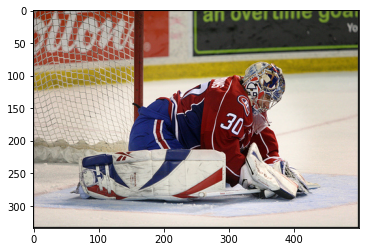

Real Caption: an ice hockey goalkeeper in red and blue strip is on his knees in front of the goal
Predicted Caption: two people are playing soccer in the ice
BLEU-1 score: 10.743929882257127
BLEU-2 score: 2.6170965635626654e-153
BLEU-3 score: 5.466985685869414e-184
BLEU-4 score: 4.0845859402864615e-230


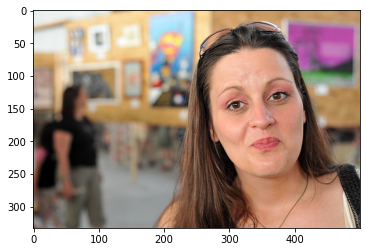

Real Caption: closeup photo of woman with sunglasses on her head at an art show
Predicted Caption: woman is making half smile at the camera
BLEU-1 score: 13.381535712974756
BLEU-2 score: 3.9921621141636406e-153
BLEU-3 score: 9.043876231738548e-184
BLEU-4 score: 6.895396983435736e-230


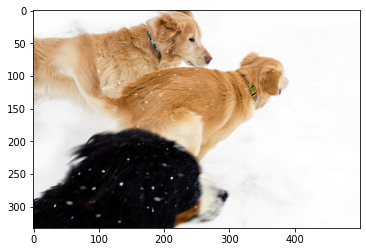

Real Caption: three dogs race through the snow
Predicted Caption: the three dogs are running in the snow
BLEU-1 score: 50.0
BLEU-2 score: 37.79644730092272
BLEU-3 score: 2.8227597581844173e-91
BLEU-4 score: 9.170599044431425e-153


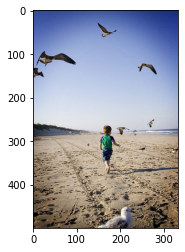

Real Caption: young child runs along beach as birds fly among him
Predicted Caption: child is running along side as birds passes by the beach
BLEU-1 score: 45.45454545454545
BLEU-2 score: 21.320071635561046
BLEU-3 score: 2.0020574018996266e-91
BLEU-4 score: 6.887578243315168e-153


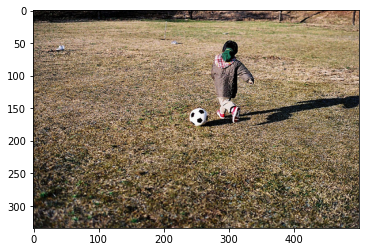

Real Caption: the young boy wearing brown coat is playing soccer
Predicted Caption: child kicks soccer ball
BLEU-1 score: 7.162619921504752
BLEU-2 score: 2.1368503961066222e-153
BLEU-3 score: 4.840838111149318e-184
BLEU-4 score: 3.690840039559348e-230


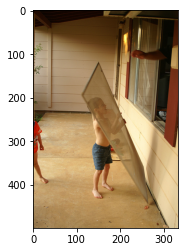

Real Caption: little boy in blue shorts holding window screen
Predicted Caption: the little boy in the red shirt is standing in front of the door
BLEU-1 score: 21.428571428571423
BLEU-2 score: 18.15682598006407
BLEU-3 score: 17.047848800266543
BLEU-4 score: 2.7961519085384024e-76


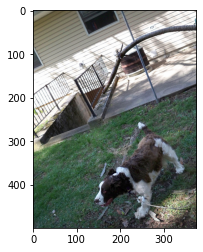

Real Caption: leashed dog is in the backyard of someone home
Predicted Caption: brown and white dog running down grassy outdoor plays in grassy yard
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


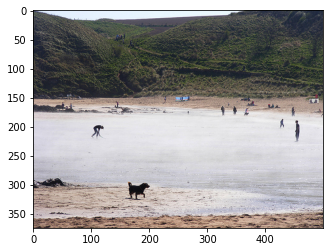

Real Caption: some people and dog are enjoying the beach of bay surrounded by green hills
Predicted Caption: people are sitting on beach along rock that has recently seen
BLEU-1 score: 20.762737819005643
BLEU-2 score: 5.930516941478545e-153
BLEU-3 score: 1.3203263178954765e-183
BLEU-4 score: 1.0022971981925034e-229


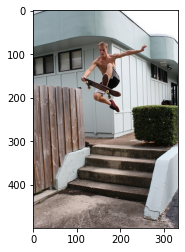

Real Caption: topless man is airborne on skateboard in front of white building
Predicted Caption: boy wearing jeans and black shirt jumps down flight of stairs
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229


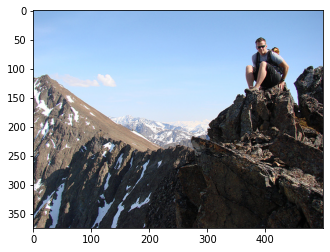

Real Caption: man sits on rock near mountains
Predicted Caption: man is sitting on top of rock high up in the mountains
BLEU-1 score: 33.33333333333333
BLEU-2 score: 8.612150057732662e-153
BLEU-3 score: 1.8419179593432007e-183
BLEU-4 score: 1.384292958842266e-229


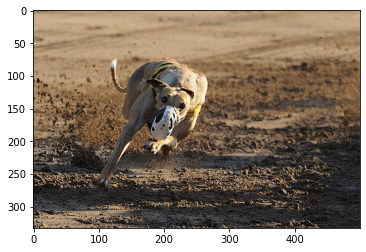

Real Caption: tan dog wearing muzzle is running on sand
Predicted Caption: the dog is kicking up the shoulder of the brown soccer ball
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


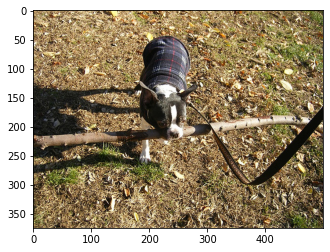

Real Caption: small black and white dog on leash wearing shirt carrying large stick
Predicted Caption: black and white dog on leash is wearing plaid outfit
BLEU-1 score: 57.31115271545873
BLEU-2 score: 51.05683283388704
BLEU-3 score: 50.09331415411219
BLEU-4 score: 43.98917247584222


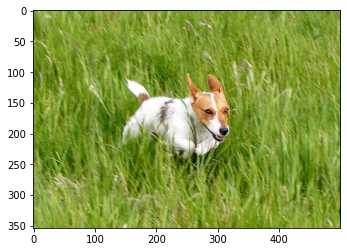

Real Caption: small dog runs through grassy field
Predicted Caption: the small white dog is running through the grass
BLEU-1 score: 33.33333333333333
BLEU-2 score: 8.612150057732662e-153
BLEU-3 score: 1.8419179593432007e-183
BLEU-4 score: 1.384292958842266e-229


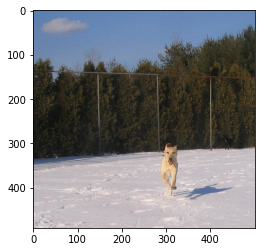

Real Caption: white dog running in the snow
Predicted Caption: dog runs in the snow fence in the background
BLEU-1 score: 44.44444444444444
BLEU-2 score: 33.333333333333336
BLEU-3 score: 28.853455719062136
BLEU-4 score: 4.335118471269586e-76


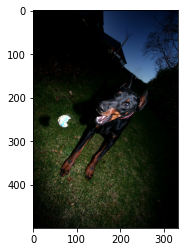

Real Caption: black and brown dog is standing outdoors at night
Predicted Caption: black dog is standing on the grass
BLEU-1 score: 42.94155960430205
BLEU-2 score: 32.797157891028675
BLEU-3 score: 28.19532273037056
BLEU-4 score: 4.054801917798201e-76


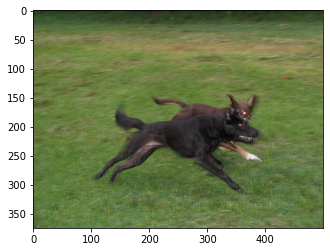

Real Caption: two dogs running on grass
Predicted Caption: two dogs are running on the grass
BLEU-1 score: 71.42857142857143
BLEU-2 score: 48.795003647426654
BLEU-3 score: 3.290247306760209e-91
BLEU-4 score: 1.0419812236391601e-152


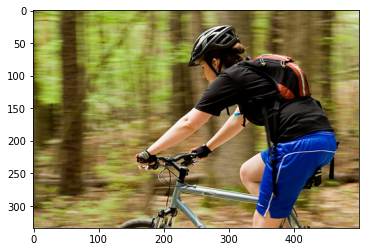

Real Caption: girl on bike is wearing backpack and helmet and riding through wooded area
Predicted Caption: woman rides her bike by some trees
BLEU-1 score: 6.062469223956427
BLEU-2 score: 2.392603769591812e-153
BLEU-3 score: 6.062124254323657e-184
BLEU-4 score: 4.753148692240233e-230


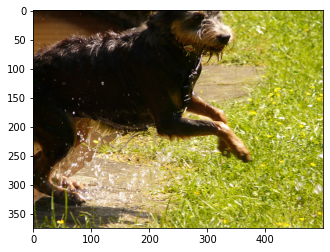

Real Caption: dog playing in water
Predicted Caption: the dog is leaping over the stream
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229


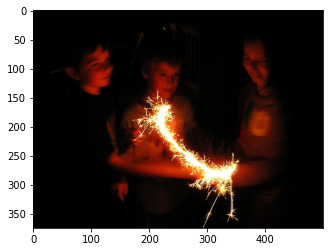

Real Caption: three children playing with sparklers
Predicted Caption: child playing with an and fishing net
BLEU-1 score: 28.57142857142857
BLEU-2 score: 21.82178902359924
BLEU-3 score: 2.030194004994321e-91
BLEU-4 score: 6.968148412761693e-153


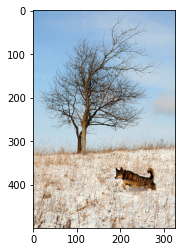

Real Caption: the brown furry animal is walking in the snowy grass with tree behind him
Predicted Caption: dog is jumping through the air off the ground fence in the woods
BLEU-1 score: 28.49111011207126
BLEU-2 score: 14.827243801836115
BLEU-3 score: 1.561265199697373e-91
BLEU-4 score: 5.527118757926412e-153


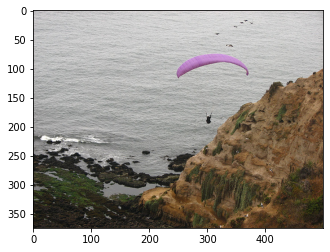

Real Caption: the purple parachutes floats off the cliff toward the grey ocean below
Predicted Caption: an individual with parachute is about to land on the ocean
BLEU-1 score: 16.601831205132044
BLEU-2 score: 5.807771944031223e-153
BLEU-3 score: 1.4022212212919266e-183
BLEU-4 score: 1.0862663708453602e-229


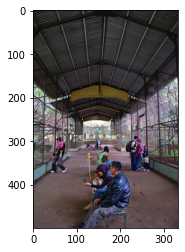

Real Caption: the people under the canopy are sitting on bench the mother is taking picture of child with her cellphone
Predicted Caption: group of people gather under in and area
BLEU-1 score: 9.481484842677993
BLEU-2 score: 2.309579611108841e-153
BLEU-3 score: 4.824597934254078e-184
BLEU-4 score: 3.6046344406433894e-230


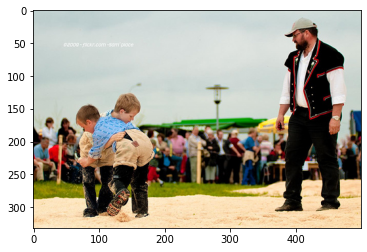

Real Caption: two young boys wrestle in the sand while man watches
Predicted Caption: two young boys wrestling while an adult looks on
BLEU-1 score: 39.77063630286087
BLEU-2 score: 29.82797722714566
BLEU-3 score: 25.81920660337923
BLEU-4 score: 3.879234451140231e-76


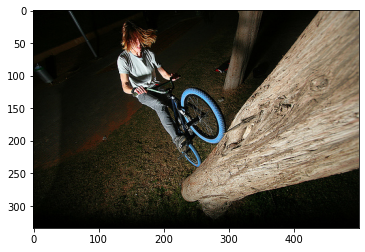

Real Caption: person is riding bike on tree
Predicted Caption: person riding bike with blue wheels on tree trunk at night
BLEU-1 score: 45.45454545454545
BLEU-2 score: 30.15113445777636
BLEU-3 score: 2.4648217855445784e-91
BLEU-4 score: 8.190757052088229e-153


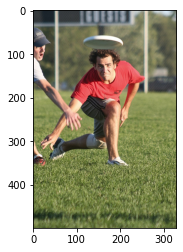

Real Caption: two men are running to catch frisbee
Predicted Caption: man in red uniform throws frisbee
BLEU-1 score: 14.108028748176901
BLEU-2 score: 5.154827976372712e-153
BLEU-3 score: 1.2664232355128374e-183
BLEU-4 score: 9.853445011990207e-230


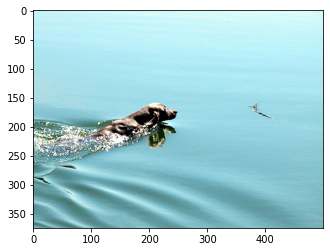

Real Caption: dog swims toward stick
Predicted Caption: the large brown dog is paddling in the water
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


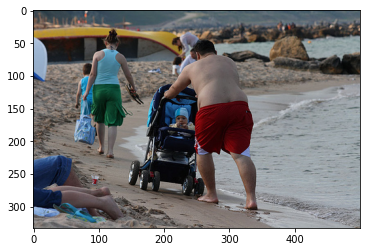

Real Caption: man in <unk> swim trunks pushing baby stroller along edge of beach
Predicted Caption: man pushes baby in carriage down the beach
BLEU-1 score: 30.326532985631673
BLEU-2 score: 6.397495320955232e-153
BLEU-3 score: 1.261683487508958e-183
BLEU-4 score: 9.291879812217675e-230


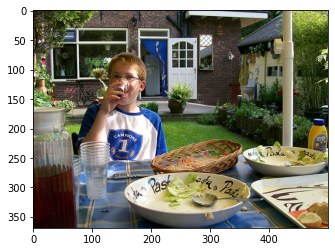

Real Caption: the boy drinks from plastic glass while sitting at table with food on it
Predicted Caption: child in blue shirt drinking out of glass
BLEU-1 score: 5.904581909262685
BLEU-2 score: 2.4911871828277866e-153
BLEU-3 score: 6.48274294660805e-184
BLEU-4 score: 5.116994679231889e-230


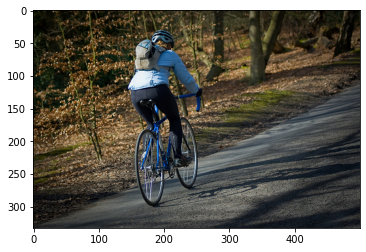

Real Caption: woman in blue jacket is riding bicycle on woodland path
Predicted Caption: woman in red jacket is on her bike by the woods
BLEU-1 score: 45.45454545454545
BLEU-2 score: 30.15113445777636
BLEU-3 score: 2.4648217855445784e-91
BLEU-4 score: 8.190757052088229e-153


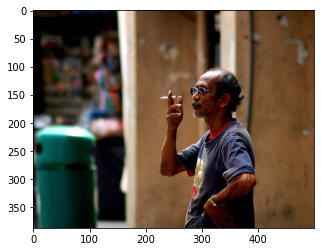

Real Caption: dark skinned man smoking cigarette near green trashcan
Predicted Caption: the man is wearing blue shirt and holding up newspaper
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229


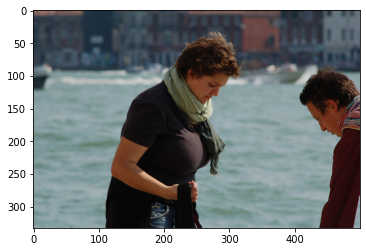

Real Caption: man and woman at the waterfront
Predicted Caption: woman and man are together in front of building
BLEU-1 score: 33.33333333333333
BLEU-2 score: 8.612150057732662e-153
BLEU-3 score: 1.8419179593432007e-183
BLEU-4 score: 1.384292958842266e-229


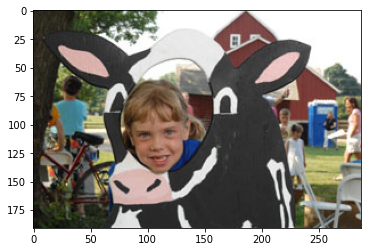

Real Caption: with barn in the background child puts her head through hole in cow cutout and smiles for the camera
Predicted Caption: girl is poking her head through cow face
BLEU-1 score: 12.641979790237324
BLEU-2 score: 9.5564384584207
BLEU-3 score: 8.238920272980318
BLEU-4 score: 1.2130225449508391e-76


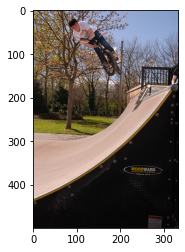

Real Caption: cyclist gets airborne on ramp
Predicted Caption: man performs bike trick on ramp
BLEU-1 score: 33.33333333333333
BLEU-2 score: 25.819888974716115
BLEU-3 score: 2.2458252053838132e-91
BLEU-4 score: 7.57965434483665e-153


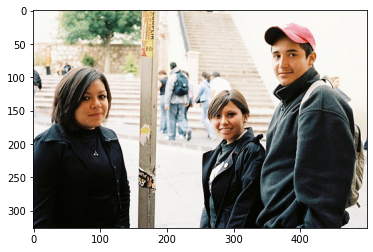

Real Caption: three young adults look towards the camera in school setting
Predicted Caption: two young men with lot of stairs in city
BLEU-1 score: 19.885318151430436
BLEU-2 score: 6.29232312294398e-153
BLEU-3 score: 1.4594457704885681e-183
BLEU-4 score: 1.1193096620723277e-229


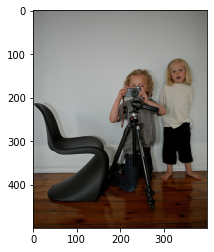

Real Caption: little girl is standing next to another little girl who is taking photograph
Predicted Caption: two young children looking at camera
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


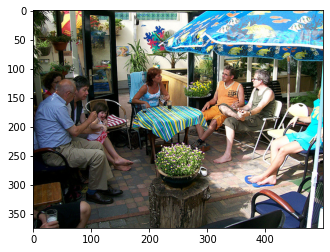

Real Caption: group of people are sitting around table under blue sunshade
Predicted Caption: several people are sitting in chairs under clear lights
BLEU-1 score: 39.77063630286087
BLEU-2 score: 29.82797722714566
BLEU-3 score: 25.81920660337923
BLEU-4 score: 3.879234451140231e-76


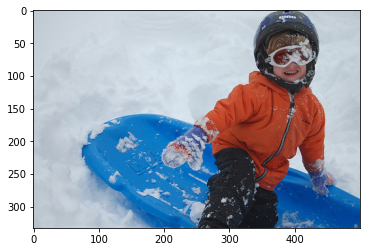

Real Caption: child on plastic sled
Predicted Caption: boy in blue coat snow
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


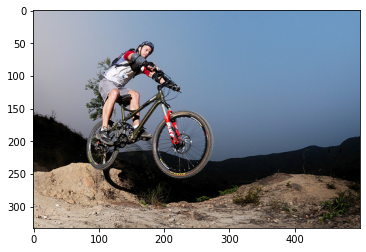

Real Caption: man jumping dirt ramp on bmx bike
Predicted Caption: man riding bike jumps over hill
BLEU-1 score: 28.2160574963538
BLEU-2 score: 7.290027635886345e-153
BLEU-3 score: 1.5591498913318324e-183
BLEU-4 score: 1.171778691554733e-229
BLEU-1 count: 195
BLEU-2 count: 103
BLEU-3 count: 44
BLEU-4 count: 10
BLEU-1 Total: 60.76119067596105
BLEU-2 Total: 28.21032461082419
BLEU-3 Total: 13.252714849368935
BLEU-4 Total: 2.8240502551393782
BLEU-1 Average: 0.3115958496203131
BLEU-2 Average: 0.273886646707031
BLEU-3 Average: 0.3011980647583849
BLEU-4 Average: 0.2824050255139378


In [ ]:
blue_1 = 0
blue_2 = 0
blue_3 = 0
blue_4 = 0
blue_count_1 = 0
blue_count_2 = 0
blue_count_3 = 0
blue_count_4 = 0
for j in range(250):
    start_token = tokenizer.word_index['<start>']
    end_token = tokenizer.word_index['<end>']
    # select random image from validation data
    rid = np.random.randint(0, len(img_name_val))
    image = img_name_val[rid]
    temp_image = np.array(Image.open(image))
    plt.imshow(temp_image)
    plt.show()
    real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
    caption,result,attention_weights = evaluate(image)

    first = real_caption.split(' ', 1)[1]
    real_caption = first.rsplit(' ', 1)[0]

    #remove "<unk>" in result
    for i in caption:
        if i=="<unk>":
            caption.remove(i)

    for i in real_caption:
        if i=="<unk>":
            real_caption.remove(i)

    #remove <end> from result         
    result_join = ' '.join(caption)
    result_final = result_join.rsplit(' ', 1)[0]

    real_appn = []
    real_appn.append(real_caption.split())
    reference = real_appn
    candidate = caption
    print ('Real Caption:', real_caption)
    print ('Predicted Caption:', ' '.join(caption))

    score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
    if score > 0.1:
        blue_1 +=score
        blue_count_1 +=1
    print(f"BLEU-1 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
    if score > 0.1:
        blue_2 +=score
        blue_count_2 +=1
    print(f"BLEU-2 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
    if score > 0.1:
        blue_3 +=score
        blue_count_3 += 1
    print(f"BLEU-3 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
    if score > 0.1:
        blue_4 +=score
        blue_count_4 += 1
    print(f"BLEU-4 score: {score*100}")

print(f"BLEU-1 count: {blue_count_1}")
print(f"BLEU-2 count: {blue_count_2}")
print(f"BLEU-3 count: {blue_count_3}")
print(f"BLEU-4 count: {blue_count_4}")
print(f"BLEU-1 Total: {blue_1}")
print(f"BLEU-2 Total: {blue_2}")
print(f"BLEU-3 Total: {blue_3}")
print(f"BLEU-4 Total: {blue_4}")
if blue_count_1 > 0:
    print(f"BLEU-1 Average: {blue_1/blue_count_1}")
if blue_count_2 > 0:
    print(f"BLEU-2 Average: {blue_2/blue_count_2}")
if blue_count_3 > 0:
    print(f"BLEU-3 Average: {blue_3/blue_count_3}")
if blue_count_4 > 0:
    print(f"BLEU-4 Average: {blue_4/blue_count_4}")